In [1]:
folder = "D:/users/marko/downloads/mirna/analysis"
folder2 = "D:/users/marko/downloads/mirna/models"
folder3 = "D:/users/marko/downloads/mirna/"

In [2]:
vae_code = "1vchzpq3"
beta_vae_code = "f7a8z5ga"
beta_iaf_vae_code = "1omrpwc6"
dc_beta_iaf_vae_code = "1pcu3ra0"
dc_iaf_diva = "2fh6vyi6"
codes = [vae_code, beta_vae_code, beta_iaf_vae_code, dc_beta_iaf_vae_code, dc_iaf_diva]

# library imports

In [3]:
import numpy as np
import pandas as pd
import sys 
import os 
import io
import wandb
import torch
import torch.distributions as dist

sys.path.insert(0, folder)
sys.path.insert(0, folder2)
os.chdir(folder)

for i in codes:
    os.makedirs(f"{folder}/latspaces/{i}/", exist_ok=True)


from concepts import *
from utils import *
from model import *
from dataset import *

from tqdm import tqdm

import plotly.graph_objs as go
from ipywidgets import HTML, Image, Layout, interactive, \
                       RadioButtons, HBox, VBox, interact
import PIL.Image
from graphviz import Digraph, Source

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

from sklearn.svm import LinearSVC, SVC
from sklearn.linear_model import LogisticRegression

from scipy.stats import pearsonr, spearmanr, kendalltau


In [4]:

class Args:
    
    def __init__(self, args, conv=False):
        if conv:
            setattr(self, 'sttng', 'conv') 
        for i in args:
            setattr(self, i, args[i])

In [5]:
models = []
args_list = []
hstry = []
api = wandb.Api(api_key='46d1be10d4e9900dd55fb752c4ecaa4ca0341b20', timeout=100)
for i in codes:    

    run = api.run(f"generativemirna/final_experiments_thesis/{i}")
    if i == "2fh6vyi6":
        args = Args(run.config, True)
        args = process_args(args)
        model = MIRDIVA(args).to('cuda')
        model.load_state_dict(torch.load('D:/users/marko/downloads/mirna/thesis_experiments/diva_iaf/checkpoints/200.pth'))
        models.append(model)
        args_list.append(args)
        hstry.append(run.scan_history(keys=["loss_train_overall",
                                            "loss_test_overall",
                                            "rec_train_overall",
                                            "rec_test_overall",
                                            "kl_loss_x_train_overall",
                                            "kl_loss_x_test_overall",
                                            "kl_loss_y_train_overall",
                                            "kl_loss_y_test_overall",
                                            "kl_loss_m_train_overall",
                                            "kl_loss_m_test_overall",
                                            "epoch"
                                            ]))
    if i == "1pcu3ra0":
        args = Args(run.config)
        args = process_args(args)
        model = MIRVAE(args).to('cuda')
        model.load_state_dict(torch.load('D:/users/marko/downloads/mirna/thesis_experiments/dc_beta_iaf_vae/checkpoints/150.pth'))
        models.append(model)
        args_list.append(args)

        hstry.append(run.scan_history(keys=["loss_train_overall",
                                    "loss_test_overall",
                                    "rec_train_overall",
                                    "rec_test_overall",
                                    "kl_loss_train_overall",
                                    "kl_loss_test_overall",
                                    "epoch"
                                    ]))
        
    if i == "1omrpwc6":
        args = Args(run.config)
        args = process_args(args)
        model = MIRVAE(args).to('cuda')
        model.load_state_dict(torch.load('D:/users/marko/downloads/mirna/thesis_experiments/beta_iaf_vae/checkpoints/150.pth'))
        models.append(model)
        args_list.append(args)

        hstry.append(run.scan_history(keys=["loss_train_overall",
                                    "loss_test_overall",
                                    "rec_train_overall",
                                    "rec_test_overall",
                                    "kl_loss_train_overall",
                                    "kl_loss_test_overall",
                                    "epoch"
                                    ]))
    if i == "f7a8z5ga":
        args = Args(run.config)
        args = process_args(args)
        model = MIRVAE(args).to('cuda')
        model.load_state_dict(torch.load('D:/users/marko/downloads/mirna/thesis_experiments/beta_vae/checkpoints/200.pth'))
        models.append(model)
        args_list.append(args)
        
        
        hstry.append(run.scan_history(keys=["loss_train_overall",
                                    "loss_test_overall",
                                    "rec_train_overall",
                                    "rec_test_overall",
                                    "kl_loss_train_overall",
                                    "kl_loss_test_overall",
                                    "epoch"
                                    ]))
    if i == "1vchzpq3":
        args = Args(run.config)
        args = process_args(args)
        model = MIRVAE(args).to('cuda')
        model.load_state_dict(torch.load('D:/users/marko/downloads/mirna/thesis_experiments/vae/checkpoints/200.pth'))
        models.append(model)
        args_list.append(args)
        
        hstry.append(run.scan_history(keys=["loss_train_overall",
                                    "loss_test_overall",
                                    "rec_train_overall",
                                    "rec_test_overall",
                                    "kl_loss_train_overall",
                                    "kl_loss_test_overall",
                                    "epoch"
                                    ]))
        

In [367]:
[i for  i in hstry[0]]

[]

In [6]:
concepts_train = pd.read_csv(f'{folder3}/data/concepts_tr.csv')
concepts_test = pd.read_csv(f'{folder3}/data/concepts_te.csv')

# concepts_train = create_annotated_df(train_loader.dataset.images*255, train_loader.dataset.labels.argmax(1))
# concepts_test = create_annotated_df(test_loader.dataset.images*255, test_loader.dataset.labels.argmax(1))

# concepts_train.to_csv(f'{folder3}/data/concepts_tr.csv')
# concepts_test.to_csv(f'{folder3}/data/concepts_te.csv')

concepts_train['loop_length'].fillna(0, inplace=True)
concepts_train['loop_width'].fillna(0, inplace=True)
concepts_train.replace(['upper','lower'], [1,-1], inplace=True)
concepts_train.fillna(-1, inplace=True)

concepts_test['loop_length'].fillna(0, inplace=True)
concepts_test['loop_width'].fillna(0, inplace=True)
concepts_test.replace(['upper','lower'], [1,-1], inplace=True)
concepts_test.fillna(-1, inplace=True)

In [7]:
concepts_test['presence_terminal_loop']

0         True
1        False
2         True
3         True
4         True
         ...  
14876     True
14877    False
14878     True
14879    False
14880    False
Name: presence_terminal_loop, Length: 14881, dtype: bool

In [8]:
train_loader = get_data_loader(folder3, 'train', analysis=True)
test_loader = get_data_loader(folder3, 'test', analysis=True)

Loading Labels! (~10s)
Loading Names! (~5s)
Loading Labels! (~10s)
Loading Names! (~5s)


In [9]:
r = test_loader.dataset.__getitem__(0)
for i in r:
    print(i.shape)

(5, 25, 100)
(3, 25, 100)
(2,)
(2, 100)


In [10]:
n = 30
np.random.seed(10081999)
idxs = np.random.choice(len(test_loader.dataset), size=n, replace=False)

x = torch.zeros((n,5,25,100)).to('cuda').float()
y = torch.zeros((n,2)).to('cuda').float()
m = torch.zeros((n,2,100)).to('cuda').float()
x_org = np.zeros((n,25,100,3))

for i in range(n):
    data = test_loader.dataset.__getitem__(idxs[i])
    x[i] = torch.tensor(data[0])
    y[i] = torch.tensor(data[2])
    m[i] = torch.tensor(data[3])
    
    x_org[i] = np.transpose(data[1], (1,2,0))


#         x = batch[1][0][:10].to('cuda').float()
#         y = batch[1][2][:10].to('cuda').float()
#         m = batch[1][3][:10].to('cuda').float()
#         x_org = batch[1][1][:10]


In [11]:
images = np.zeros((n,6,25,100,3))
images[:,0] = x_org

for i in range(len(models)):
    model = models[i]
    if model.type == 'diva':
        _, _, _, _, _, _, color, bar_t, bar_b = model(x,y,m)
    else:
        _, _, _, _, _, color, bar_t, bar_b = model(x,y,m)
    
    rec = model.dec.sample(color, bar_t, bar_b)
    images[:,i+1] = rec

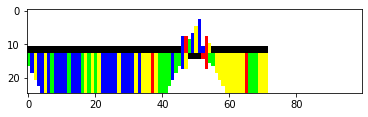

In [12]:
plt.imshow(images[0,0])

In [64]:
dst = x_tr[:,:,12,:].sum((1,2))

In [65]:
sum(dst>70)

3959

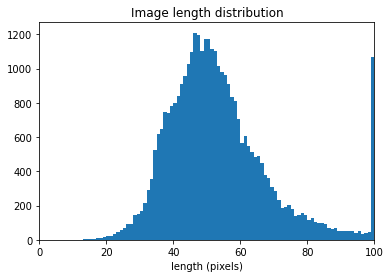

In [70]:
plt.hist(dst, bins=np.arange(0,101,1))
plt.xlim(0,100)
plt.title("Image length distribution")
plt.xlabel("length (pixels)")
plt.savefig("figures/length.png")

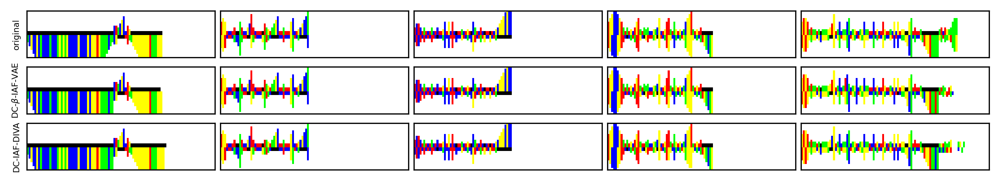

In [52]:
names = ['original', r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=3, ncols=5, figsize=(9,2), dpi=300)
for i in range(3):
    for j in range(5):
        
        imi =i
        if i >= 1:
            imi=i+3
        
        ax[i,j].imshow(images[j,imi])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        if j == 0:
            ax[i,j].set_ylabel(names[i], fontsize=5.5)
fig.tight_layout(pad=0.01, h_pad=-2.5)
fig.savefig('figures/reconstructions_pp.png')

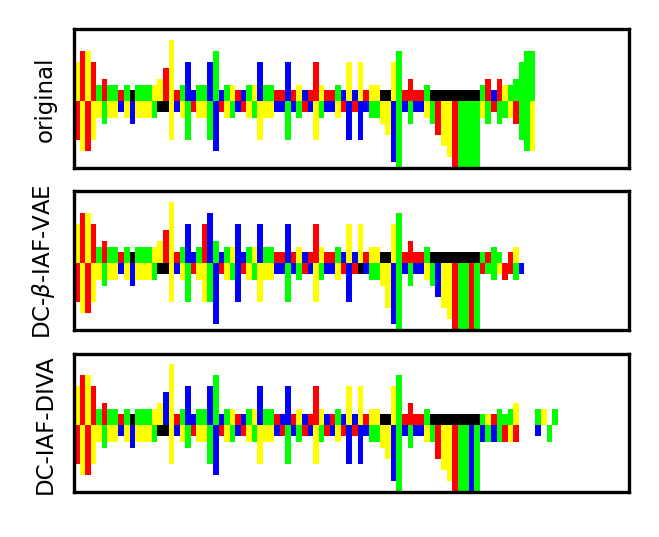

In [56]:
names = ['original', r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=3, ncols=1, figsize=(2,2), dpi=300)
for i in range(3):
    for j in range(1):
        
        imi =i
        if i >= 1:
            imi=i+3
        
        ax[i].imshow(images[4,imi])
        ax[i].set_xticks([],[])
        ax[i].set_yticks([],[])
        ax[i].set_ylabel(names[i], fontsize=5.5)
fig.tight_layout(pad=0.01, h_pad=-2.5)
fig.savefig('figures/reconstructions_pp_zoom.png')

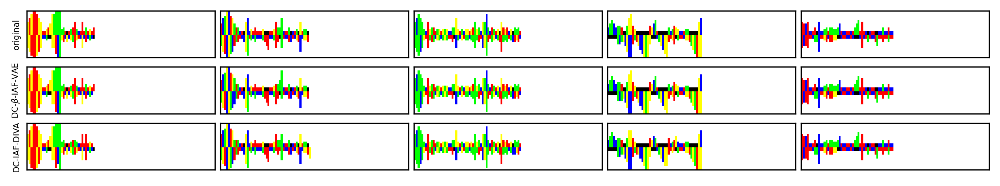

In [53]:
names = ['original', r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=3, ncols=5, figsize=(9,2), dpi=300)
for i in range(3):
    for j in range(5):
        
        imi =i
        if i >= 1:
            imi=i+3
        
        ax[i,j].imshow(images[j+5,imi])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        if j == 0:
            ax[i,j].set_ylabel(names[i], fontsize=5.5)
fig.tight_layout(pad=0.01, h_pad=-2.5)
fig.savefig('figures/reconstructions_pp2.png')

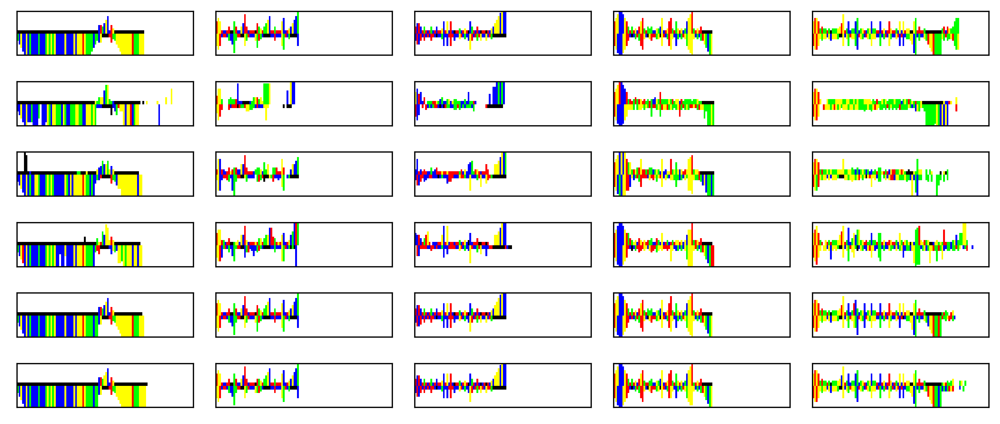

In [15]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main.pdf')

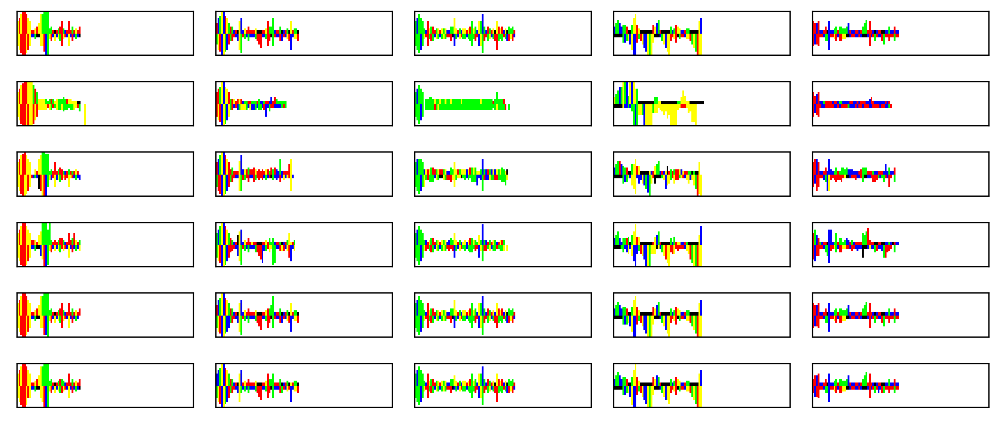

In [14]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j+5,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main2.pdf')

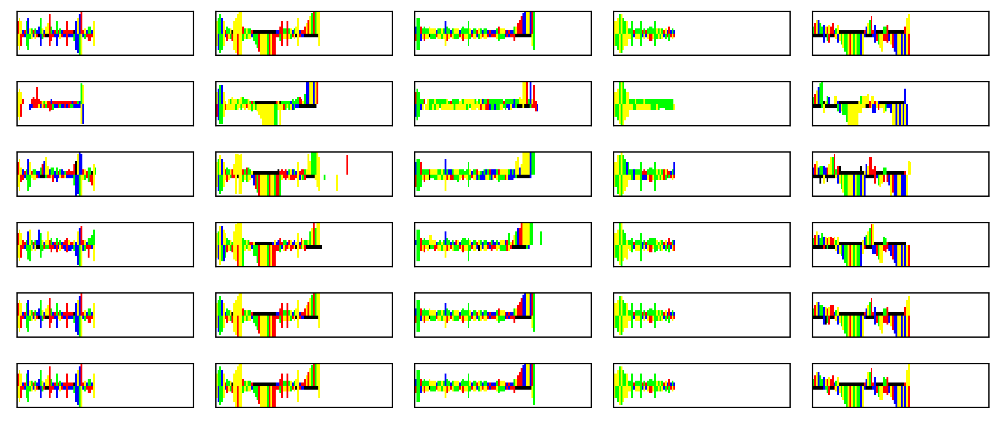

In [15]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j+10,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main3.pdf')

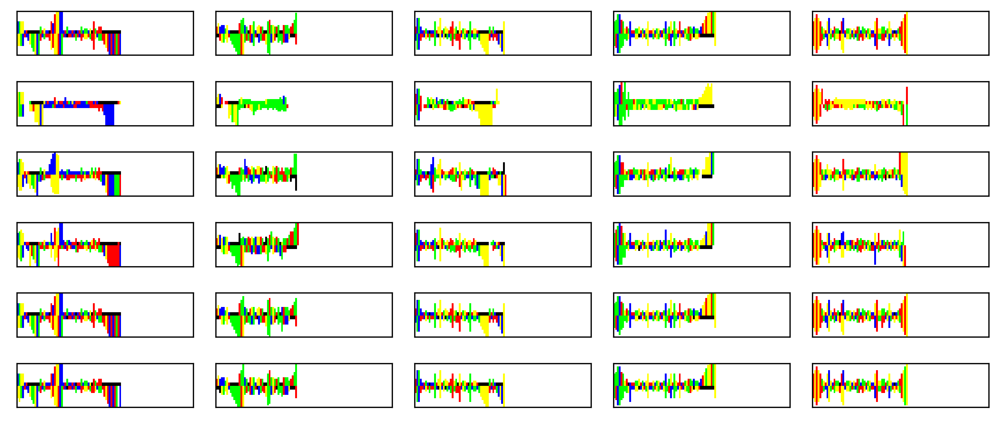

In [16]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j+15,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main4.pdf')

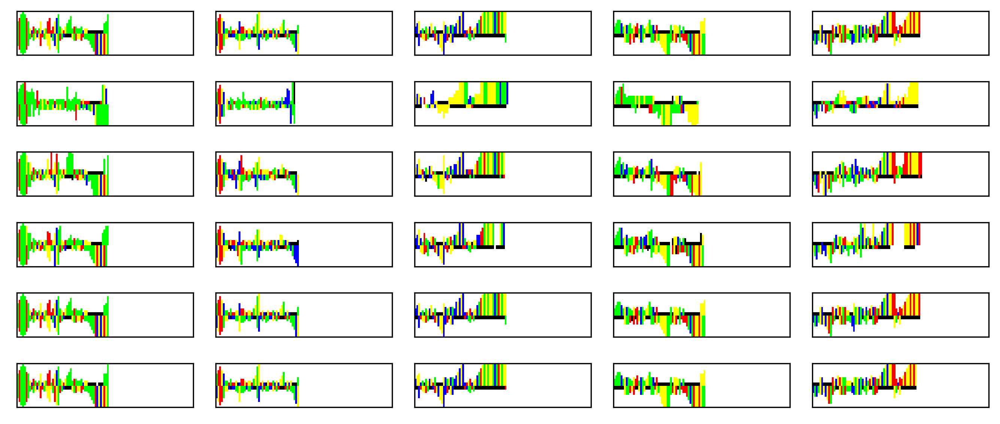

In [17]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j+20,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main5.pdf')

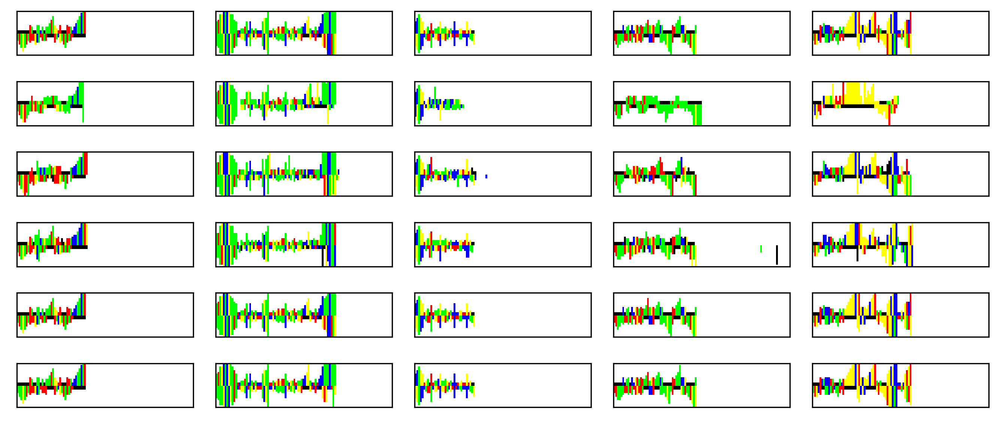

In [96]:
names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
fig, ax = plt.subplots(nrows=6, ncols=5, figsize=(9,4), dpi=300)
for i in range(6):
    for j in range(5):
        
        ax[i,j].imshow(images[j+25,i])
        ax[i,j].set_xticks([],[])
        ax[i,j].set_yticks([],[])
        #if j == 0:
        #    ax[i,j].set_ylabel(names[i], fontsize=8)
fig.tight_layout()
fig.savefig('figures/reconstructions_main6.pdf')

In [19]:
# names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
# fig, ax = plt.subplots(nrows=6, ncols=10, figsize=(100,15))
# for i in range(6):
#     for j in range(10):
        
#         ax[i,j].imshow(images[j+10,i])
#         ax[i,j].set_xticks([],[])
#         ax[i,j].set_yticks([],[])
#         if j == 0:
#             ax[i,j].set_ylabel(names[i], fontsize=20)
# fig.tight_layout()
# fig.savefig('/figures/reconstructions2.png')

In [20]:
# names = ['original', 'VAE', r"$\beta$-VAE", r"$\beta$-IAF-VAE", r"DC-$\beta$-IAF-VAE", "DC-IAF-DIVA"]
# fig, ax = plt.subplots(nrows=6, ncols=10, figsize=(100,15))
# for i in range(6):
#     for j in range(10):
        
#         ax[i,j].imshow(images[j+20,i])
#         ax[i,j].set_xticks([],[])
#         ax[i,j].set_yticks([],[])
#         if j == 0:
#             ax[i,j].set_ylabel(names[i], fontsize=20)
# fig.tight_layout()
# fig.savefig('/figures/reconstructions3.png')

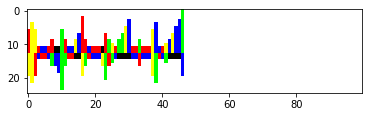

In [21]:
plt.imshow(x_org[1])

In [16]:
df = pd.DataFrame(columns = ['MAE','MAE nucleotide', 'MAE length'])
errs = np.zeros((5,25,100))
for i in range(len(models)):
    stats = {}
    z_te, x_hat_te, x_te = model_analysis(models[i], args_list[i], test_loader)
    errs[i] = 1 - (x_te == x_hat_te).prod(1).mean(0)
    stats['MAE'] = 1-(x_te==x_hat_te).prod(1).mean().round(4)
    stats['MAE nucleotide'] = 1-correct_nucleotides(x_te, x_hat_te).mean().round(4)
    stats['MAE length'] = wrong_shape(x_te, x_hat_te).mean().round(4)
    
    df.loc[names[i+1]] = stats


117batch [00:09, 12.57batch/s]
117batch [00:04, 26.06batch/s]
117batch [00:06, 16.80batch/s]
117batch [00:09, 12.43batch/s]
117batch [00:14,  8.24batch/s]


In [25]:
errs.max()

0.6388011558363014

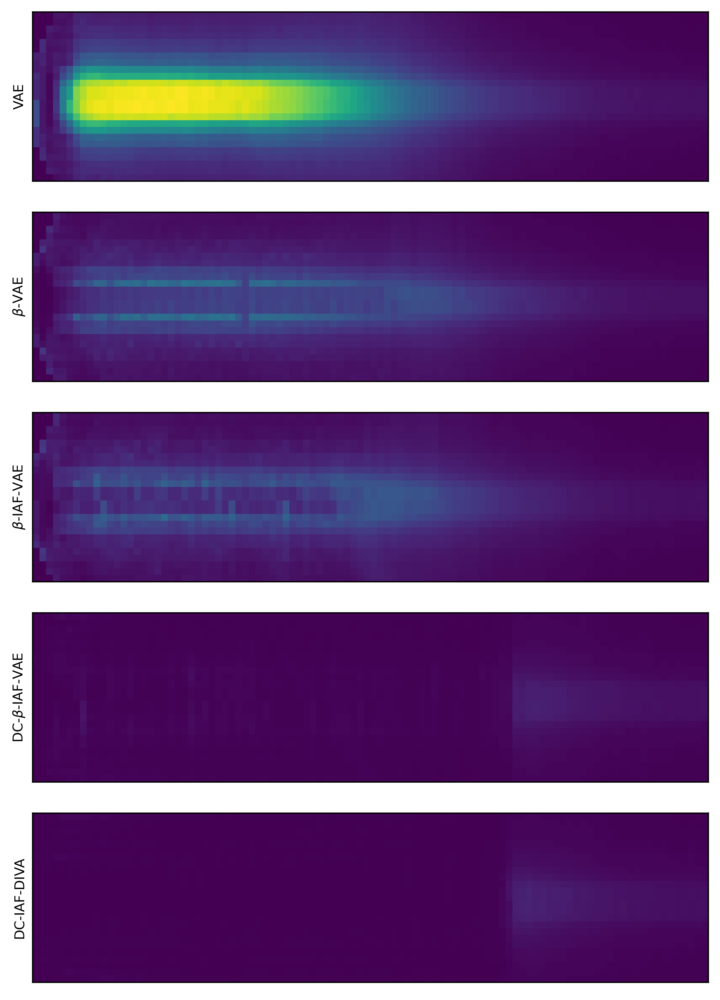

In [17]:
fig, ax = plt.subplots(nrows=5, figsize=(6,8.5), dpi=400)
for i in range(5):
    ax[i].imshow(errs[i], vmin=0, vmax=errs.max())
    ax[i].set_xticks([],[])
    ax[i].set_yticks([],[])
    ax[i].set_ylabel(names[i+1], fontsize=8)
plt.tight_layout()
fig.savefig('figures/error_dist.png')

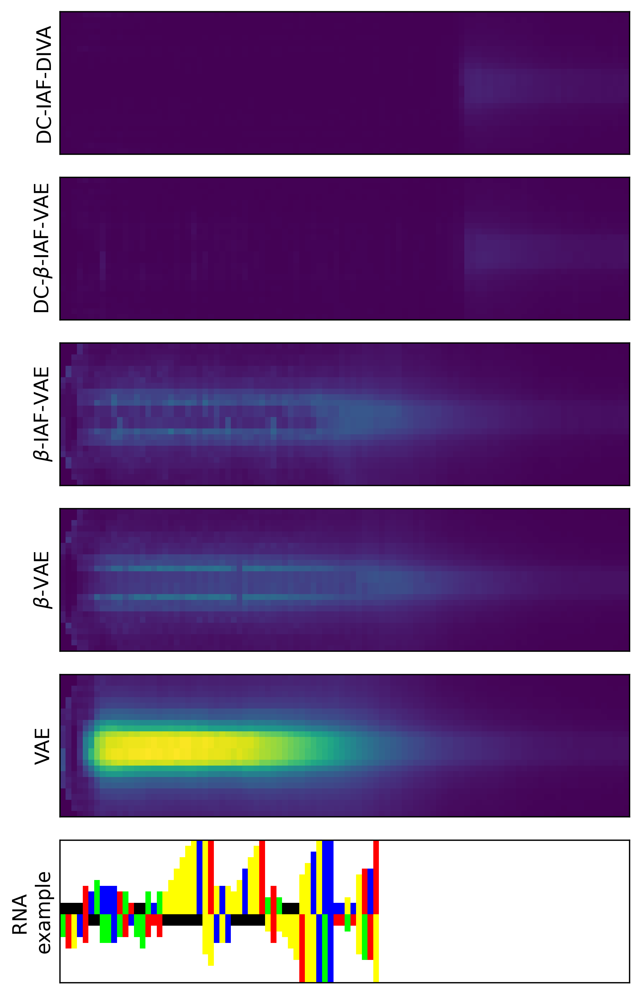

In [97]:
from matplotlib.lines import Line2D
fig, ax = plt.subplots(nrows=6, figsize=(6,8.5+1/7), dpi=400)
for i in range(5):
    ax[i].imshow(errs[-1-i], vmin=0, vmax=errs.max())
    ax[i].set_xticks([],[])
    ax[i].set_yticks([],[])
    ax[i].set_ylabel(names[-1-i], fontsize=12)
ax[-1].imshow(x_org[29])
ax[-1].set_xticks([],[])
ax[-1].set_yticks([],[])
ax[-1].set_ylabel(f"RNA \nexample", fontsize=12)


legend_elements = [Line2D([0], [0], color='y', lw=6, label='0.64'),
                   Line2D([0], [0], color='purple', lw=6, label='0.00'),
                   ]

#fig.legend(handles=legend_elements)



plt.tight_layout()
fig.savefig('figures/error_dist_pp.png')

In [ ]:
1+2

In [27]:
print(df.to_latex())

\begin{tabular}{lrrr}
\toprule
{} &     MAE &  MAE nucleotide &  MAE length \\
\midrule
VAE                &  0.1363 &          0.3054 &      0.7846 \\
\$\textbackslash beta\$-VAE        &  0.0550 &          0.0919 &      0.4780 \\
\$\textbackslash beta\$-IAF-VAE    &  0.0531 &          0.0823 &      0.4442 \\
DC-\$\textbackslash beta\$-IAF-VAE &  0.0085 &          0.0150 &      0.0670 \\
DC-IAF-DIVA        &  0.0068 &          0.0122 &      0.0568 \\
\bottomrule
\end{tabular}



In [55]:
z_diva, x_hat_te, x_te = model_analysis(models[-1], args_list[-1], test_loader)
z_diva_tr, x_hat_tr, x_tr = model_analysis(models[-1], args_list[-1], train_loader)
z_vae, x_hat_te, x_te = model_analysis(models[-2], args_list[-2], test_loader)

117batch [00:14,  7.89batch/s]
272batch [01:04,  4.24batch/s]
117batch [00:41,  2.81batch/s]


In [71]:
latent_space_m = TSNE(random_state=10).fit_transform(z_diva['m'])

In [72]:
latent_space = TSNE(random_state=10).fit_transform(z_vae['x'])

In [81]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
latent_space_pca = pca.fit_transform(z_diva['m'])

In [83]:
pca.explained_variance_ratio_

array([0.14990513, 0.1102724 ])

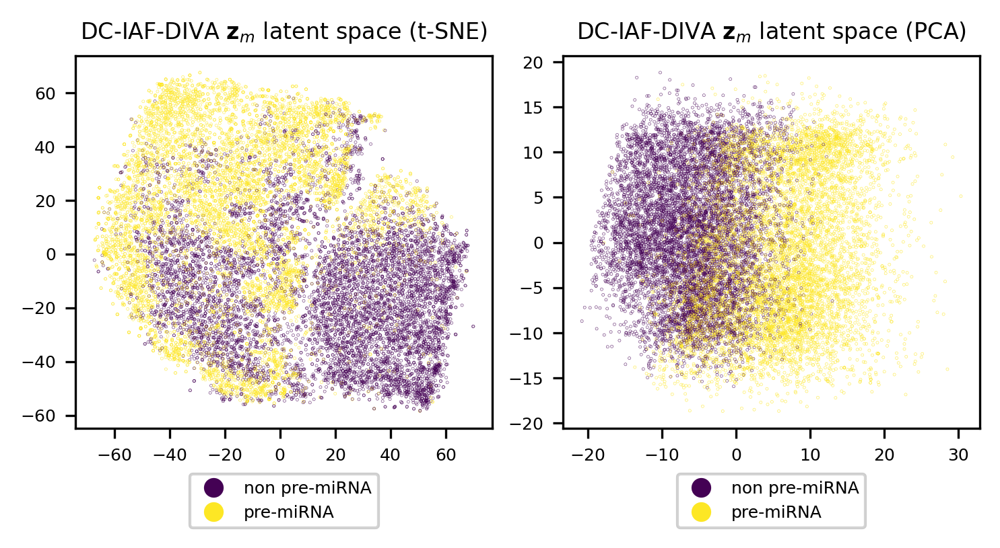

In [90]:
f= compare_latent_space_pca(latent_space_m,latent_space_pca,test_loader.dataset.labels.argmax(1).flatten(), ['non pre-miRNA', 'pre-miRNA'])
#plt.subplots_adjust(bottom=0.1)
f.savefig('figures/pca1.png', bbox_inches="tight")

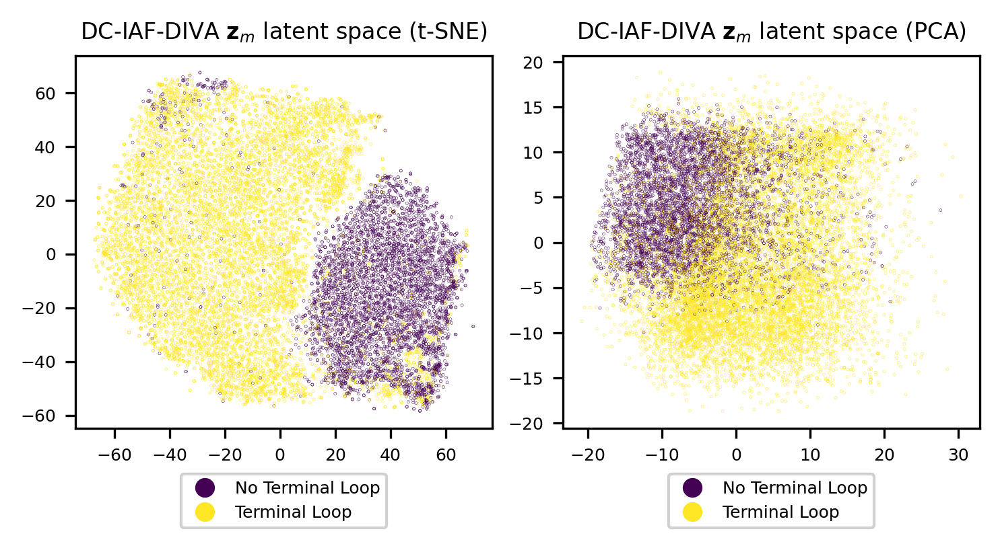

In [91]:
f = compare_latent_space_pca(latent_space_m,latent_space_pca,concepts_test['presence_terminal_loop'], ['No Terminal Loop', 'Terminal Loop'])
f.savefig('figures/pca2.png', bbox_inches="tight")

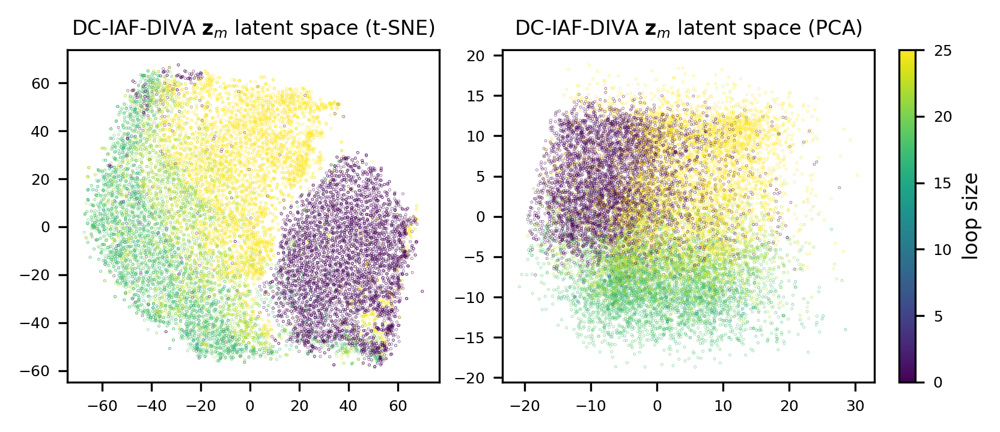

In [92]:
f = compare_latent_space_pca(latent_space_m,latent_space_pca,concepts_test['loop_length'], None, False, "loop size")
f.savefig('figures/pca3.png', bbox_inches="tight")

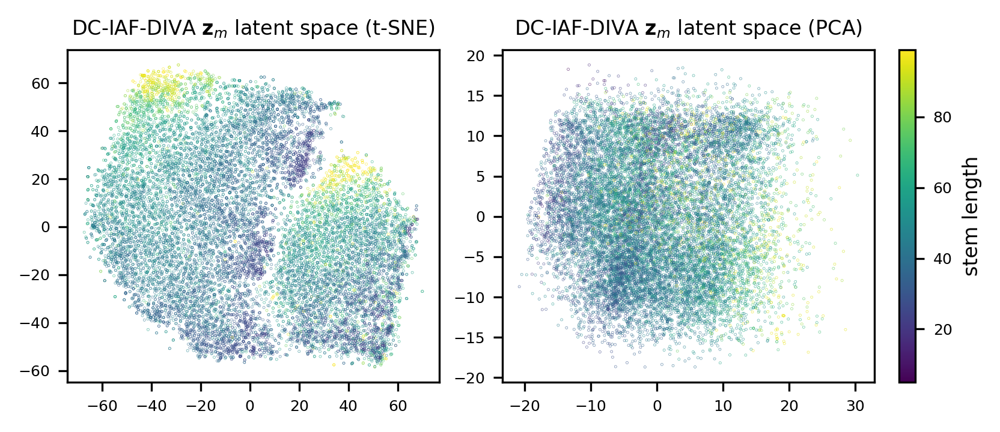

In [93]:
f = compare_latent_space_pca(latent_space_m,latent_space_pca,concepts_test['stem_length'],None, False, "stem length")
f.savefig('figures/pca4.png', bbox_inches="tight")

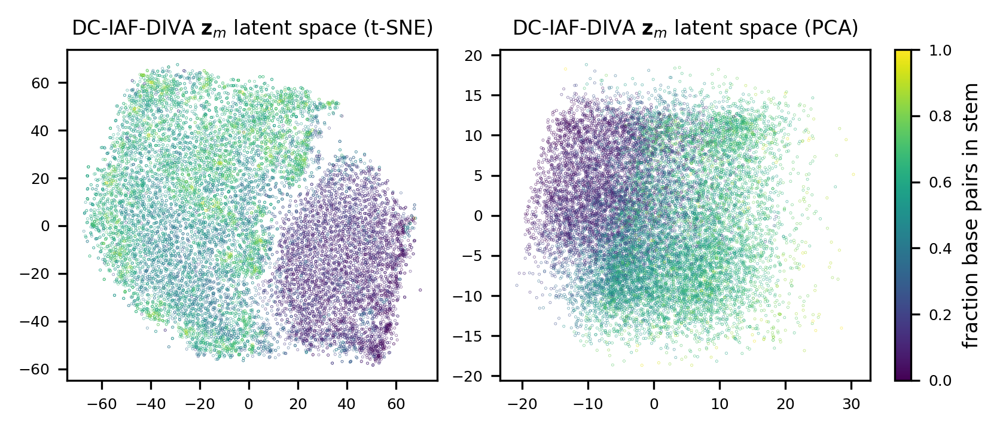

In [94]:
f = compare_latent_space_pca(latent_space_m,latent_space_pca,concepts_test['base_pairs_in_stem'],None, False, "fraction base pairs in stem")
f.savefig('figures/pca5.png', bbox_inches="tight")

In [89]:
def compare_latent_space_pca(z1, z2, c, labels, legend=True, clabel='None'):
    fig, ax = plt.subplots(ncols=2, figsize=(6,2.5), dpi=300)#, sharex=True, sharey=True)
    
    ax[0].tick_params(labelsize=6)
    ax[1].tick_params(labelsize=6)
    
    sc0 = plot_latent_space(z1, c, ax[0])
    sc1 = plot_latent_space(z2, c, ax[1])
    ax[0].set_title(r'DC-IAF-DIVA $\mathbf{z}_m$ latent space (t-SNE)', fontsize=8)
    ax[1].set_title(r'DC-IAF-DIVA $\mathbf{z}_m$ latent space (PCA)', fontsize=8)
    
   
 
    
    if legend:
        if labels is None:
            handles, labels = sc0.legend_elements()
        else:
            handles, _ = sc0.legend_elements()
        legend0 = ax[0].legend(handles, labels,
                               fontsize=6, loc='upper center',
                               bbox_to_anchor=(0.5, -0.1),
                               fancybox=True)

        if labels is None:
            handles, labels = sc1.legend_elements()
        else:
            handles, _ = sc1.legend_elements()
        legend1 = ax[1].legend(handles, labels,
                        fontsize=6, loc='upper center',
                               bbox_to_anchor=(0.5, -0.1),
          fancybox=True)
        ax[0].add_artist(legend0)
        ax[1].add_artist(legend1)
        #fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.005)
        plt.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        #cbar0 = plt.colorbar(sc0, ax=ax[0],pad=0.025)
        #cbar1 = plt.colorbar(sc1, ax=ax[1],pad=0.025)
        
        #cbar0.set_label(clabel, fontsize=8)
        cbar.set_label(clabel, fontsize=8)
        
        fig.delaxes(fig.axes[2])
        
      
        #fig.delaxes(fig.axes[2])
        #cbar0.remove()
        #cbar1.remove()
        
    else:
        
        
        #cbar0 = plt.colorbar(sc0, ax=ax[0],pad=0.025)
        #cbar1 = plt.colorbar(sc1, ax=ax[1],pad=0.025)
        
        
        plt.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        #cbar0.ax.tick_params(labelsize=6) 
        cbar.ax.tick_params(labelsize=6) 
        cbar.set_label(clabel, fontsize=8)
        
        #cbar1.set_label(clabel, fontsize=8)
   
    return fig


def compare_latent_space(z1, z2, c, labels, legend=True, clabel='None'):
    fig, ax = plt.subplots(ncols=2, figsize=(6,2.5), dpi=300, sharex=True, sharey=True)
    
    ax[0].tick_params(labelsize=6)
    ax[1].tick_params(labelsize=6)
    
    sc0 = plot_latent_space(z1, c, ax[0])
    sc1 = plot_latent_space(z2, c, ax[1])
    ax[0].set_title(r'DC-IAF-DIVA $\mathbf{z}_m$ latent space', fontsize=8)
    ax[1].set_title(r'DC-$\beta$-IAF-VAE $\mathbf{z}$ latent space', fontsize=8)
    
   
 
    
    if legend:
        if labels is None:
            handles, labels = sc0.legend_elements()
        else:
            handles, _ = sc0.legend_elements()
        legend0 = ax[0].legend(handles, labels,
                               fontsize=6, loc='upper center',
                               bbox_to_anchor=(0.5, -0.1),
                               fancybox=True)

        if labels is None:
            handles, labels = sc1.legend_elements()
        else:
            handles, _ = sc1.legend_elements()
        legend1 = ax[1].legend(handles, labels,
                        fontsize=6, loc='upper center',
                               bbox_to_anchor=(0.5, -0.1),
          fancybox=True)
        ax[0].add_artist(legend0)
        ax[1].add_artist(legend1)
        #fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.005)
        plt.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        #cbar0 = plt.colorbar(sc0, ax=ax[0],pad=0.025)
        #cbar1 = plt.colorbar(sc1, ax=ax[1],pad=0.025)
        
        #cbar0.set_label(clabel, fontsize=8)
        cbar.set_label(clabel, fontsize=8)
        
        fig.delaxes(fig.axes[2])
        
      
        #fig.delaxes(fig.axes[2])
        #cbar0.remove()
        #cbar1.remove()
        
    else:
        
        
        #cbar0 = plt.colorbar(sc0, ax=ax[0],pad=0.025)
        #cbar1 = plt.colorbar(sc1, ax=ax[1],pad=0.025)
        
        
        plt.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        #cbar0.ax.tick_params(labelsize=6) 
        cbar.ax.tick_params(labelsize=6) 
        cbar.set_label(clabel, fontsize=8)
        
        #cbar1.set_label(clabel, fontsize=8)
   
    return fig

def diva_latent_space(zm,zx,zy,c,labels=None,clabel="none"):
    fig, ax = plt.subplots(ncols=3, figsize=(6.5,2.2), dpi=300, sharex=True, sharey=True)
    sc0 = plot_latent_space(zm, c, ax[0])
    sc1 = plot_latent_space(zx, c, ax[1])
    sc2 = plot_latent_space(zy, c, ax[2])
    
    ax[0].set_title(r'$\mathbf{z}_m$ latent space', fontsize=8)
    ax[1].set_title(r'$\mathbf{z_x}$ latent space', fontsize=8)
    ax[2].set_title(r'$\mathbf{z}_y$ latent space', fontsize=8)
    
    ax[0].tick_params(labelsize=6)
    ax[1].tick_params(labelsize=6)
    ax[2].tick_params(labelsize=6)
    

    
    if labels is not None:
        handles, _ = sc0.legend_elements()

        legend0 = ax[0].legend(handles, labels,
                            fontsize=6, loc='upper center',
                               bbox_to_anchor=(0.5, -0.1), 
                               fancybox=True)

        legend1 = ax[1].legend(handles, labels, fontsize=6,
                              loc='upper center',
                               bbox_to_anchor=(0.5, -0.1), fancybox=True)

        legend2 = ax[2].legend(handles, labels, fontsize=6,
                              loc='upper center',
                               bbox_to_anchor=(0.5, -0.1), fancybox=True)

        ax[0].add_artist(legend0)
        ax[1].add_artist(legend1)
        ax[2].add_artist(legend2)
        
        
        fig.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        cbar.set_label(clabel, fontsize=8)
        
        fig.delaxes(fig.axes[3])
    else:
        fig.tight_layout()
        cbar = fig.colorbar(sc1, ax=ax.ravel().tolist(),pad=0.025)
        #cbar0.ax.tick_params(labelsize=6) 
        cbar.ax.tick_params(labelsize=6) 
        cbar.set_label(clabel, fontsize=8)
        
    return fig
        

def plot_latent_space(z, c, ax):
    return ax.scatter(z[:,0], z[:,1], c=c, s=.05, marker='.')

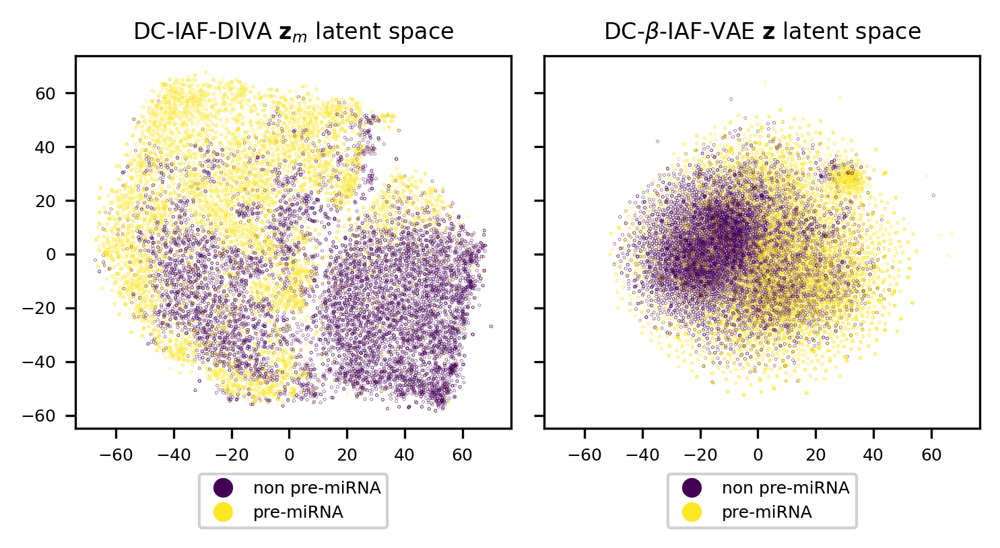

In [32]:
f= compare_latent_space(latent_space_m,latent_space,test_loader.dataset.labels.argmax(1).flatten(), ['non pre-miRNA', 'pre-miRNA'])
#plt.subplots_adjust(bottom=0.1)
f.savefig('figures/VAEvDIVA.png', bbox_inches="tight")

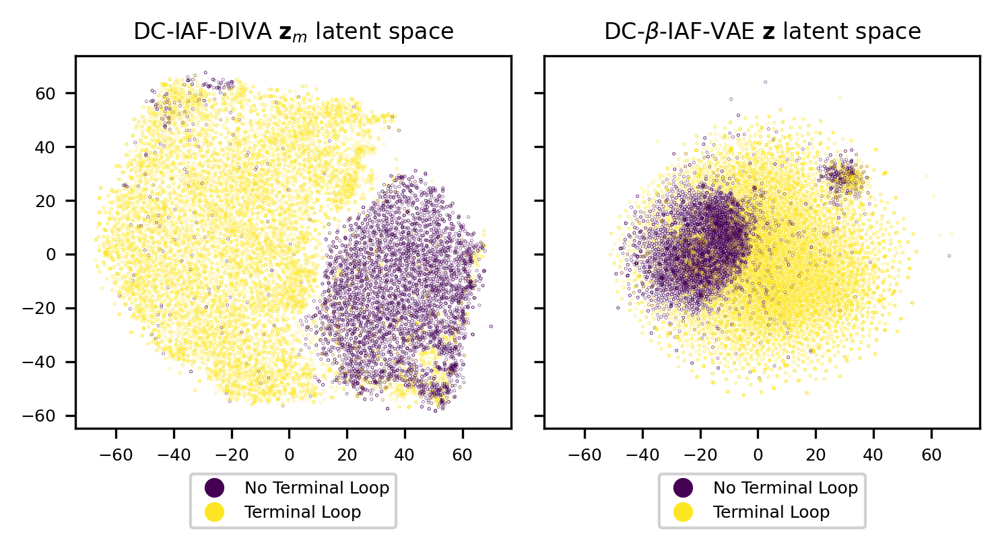

In [33]:
f = compare_latent_space(latent_space_m,latent_space,concepts_test['presence_terminal_loop'], ['No Terminal Loop', 'Terminal Loop'])
f.savefig('figures/VAEvDIVA_terminal.png', bbox_inches="tight")

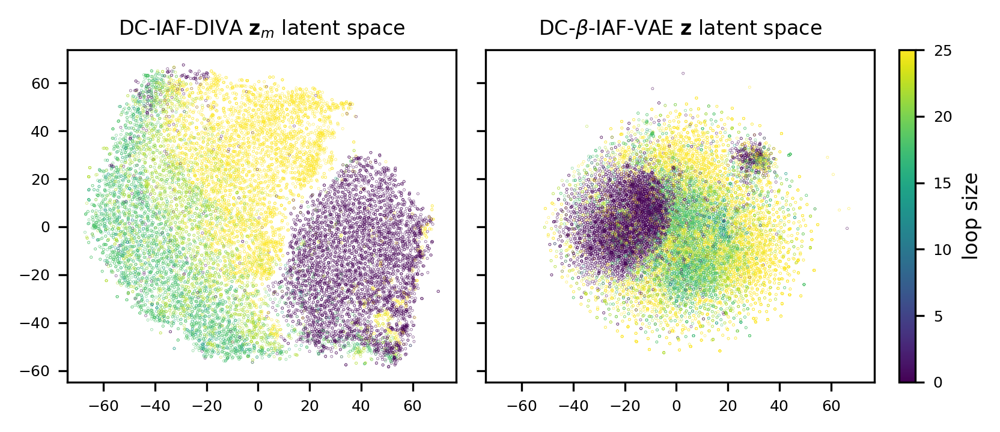

In [34]:
f = compare_latent_space(latent_space_m,latent_space,concepts_test['loop_length'], None, False, "loop size")
f.savefig('figures/VAEvDIVA_width.png', bbox_inches="tight")

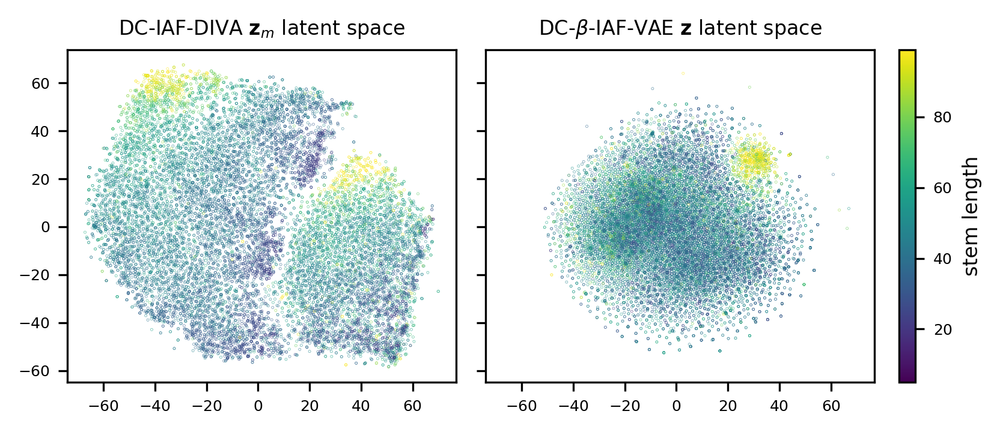

In [35]:
f = compare_latent_space(latent_space_m,latent_space,concepts_test['stem_length'],None, False, "stem length")
f.savefig('figures/VAEvDIVA_stem.png', bbox_inches="tight")

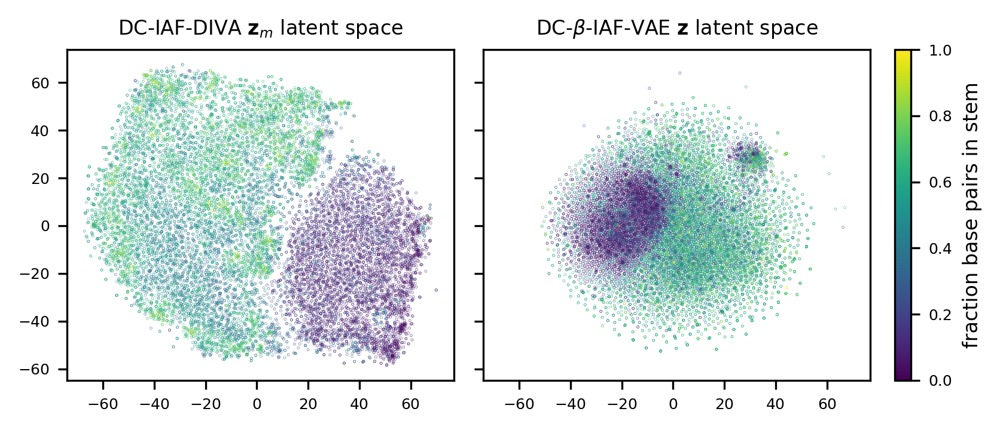

In [36]:
f = compare_latent_space(latent_space_m,latent_space,concepts_test['base_pairs_in_stem'],None, False, "fraction base pairs in stem")
f.savefig('figures/VAEvDIVA_pairs.png', bbox_inches="tight")

In [37]:
latent_space_x = TSNE(random_state=10).fit_transform(z_diva['x'])
latent_space_y = TSNE(random_state=10).fit_transform(z_diva['y'])

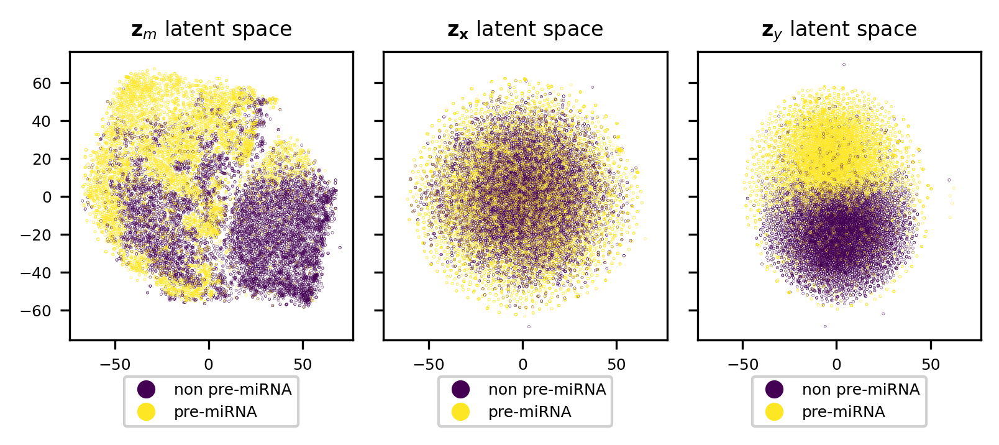

In [38]:
f = diva_latent_space(latent_space_m, latent_space_x, latent_space_y, test_loader.dataset.labels.argmax(1).flatten(), labels=['non pre-miRNA', 'pre-miRNA'])
f.savefig('figures/divals.png', bbox_inches="tight")

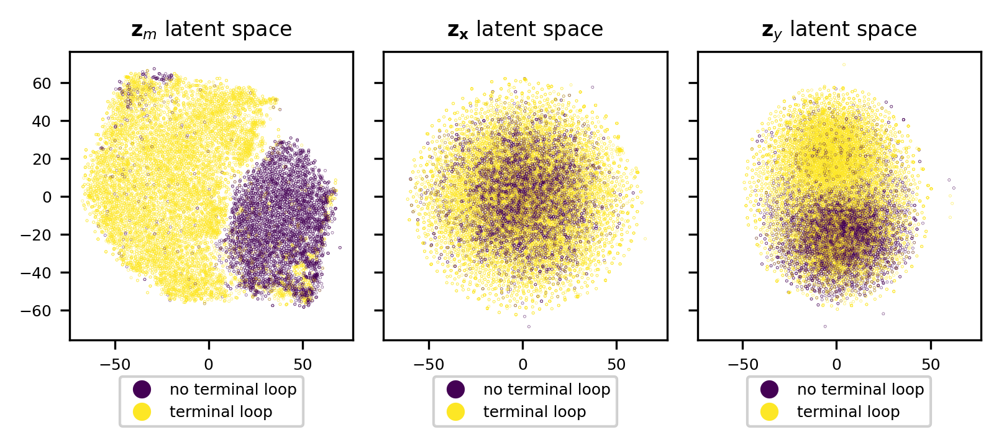

In [39]:
f = diva_latent_space(latent_space_m, latent_space_x, latent_space_y, concepts_test['presence_terminal_loop'], labels=['no terminal loop', 'terminal loop'])
f.savefig('figures/divaterminal.png', bbox_inches="tight")

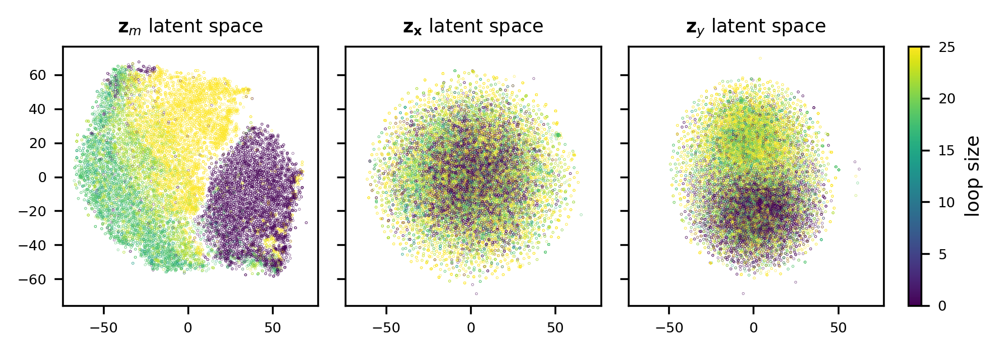

In [40]:
f = diva_latent_space(latent_space_m, latent_space_x, latent_space_y, concepts_test['loop_length'], clabel="loop size")#, labels=['no terminal loop', 'terminal loop'])
f.savefig('figures/divalooplength.png', bbox_inches="tight")

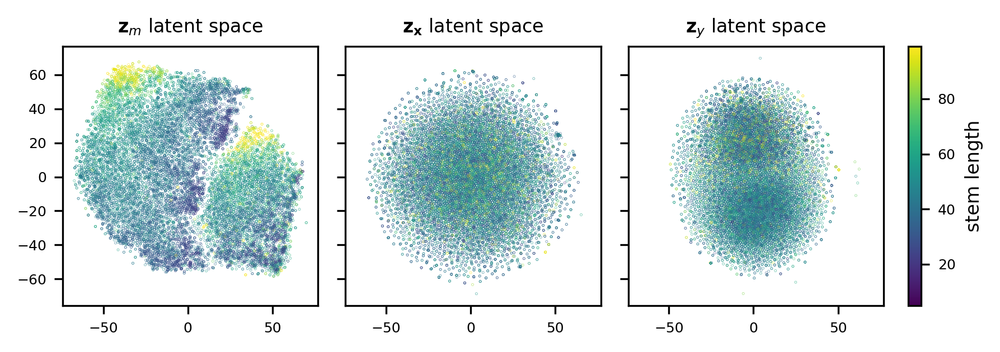

In [41]:
f = diva_latent_space(latent_space_m, latent_space_x, latent_space_y, concepts_test['stem_length'], clabel="stem length")#, labels=['no terminal loop', 'terminal loop'])
f.savefig('figures/divastemlength.png', bbox_inches="tight")

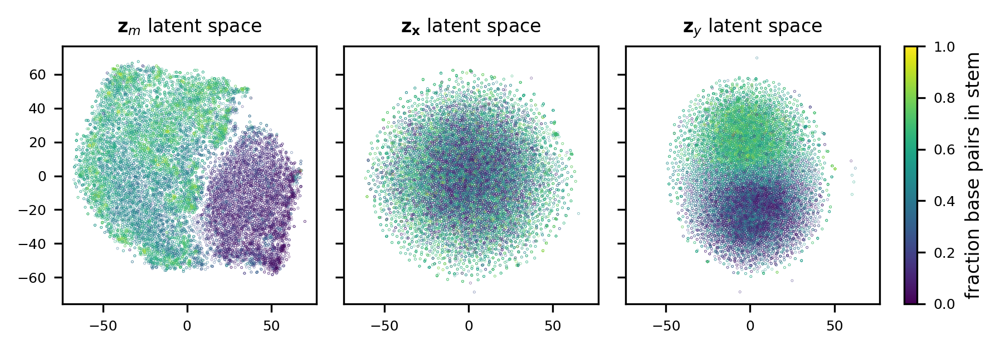

In [42]:
f = diva_latent_space(latent_space_m, latent_space_x, latent_space_y, concepts_test['base_pairs_in_stem'], clabel="fraction base pairs in stem")#, labels=['no terminal loop', 'terminal loop'])
f.savefig('figures/divabasepairs.png', bbox_inches="tight")

In [43]:
def get_images(idx1=None, idx2=None):
    if idx1 is None:
        idx1 = np.random.randint(0, len(test_loader.dataset))
    if idx2 is None:
        idx2 = np.random.randint(0, len(test_loader.dataset))
    
    im1_cat, im1, _, _ = test_loader.dataset.__getitem__(idx1)
    im2_cat, im2, _, _ = test_loader.dataset.__getitem__(idx2)
    
    return torch.tensor(im1_cat)[None], torch.tensor(im2_cat)[None], torch.tensor(im1), torch.tensor(im2), idx1, idx2

In [44]:
def generate_z(im1_cat, im2_cat):
    with torch.no_grad():
        model.eval()
        z_y = diva_encoder(im1_cat.to('cuda').float(), True, model.encs_y, model.flows_y)
        z_x = diva_encoder(im1_cat.to('cuda').float(), True, model.encs_x, model.flows_x)
        z_m = diva_encoder(im1_cat.to('cuda').float(), True, model.encs_m, model.flows_m) 
        
        z_a = torch.cat([z_x,z_y,z_m],1).clone()
        
        _, c, lt, lb = model.dec([z_x,z_y,z_m])
        rec_a = model.dec.sample(c, lt, lb)
        
        z_y = diva_encoder(im2_cat.to('cuda').float(), True, model.encs_y, model.flows_y)
        z_x = diva_encoder(im2_cat.to('cuda').float(), True, model.encs_x, model.flows_x)
        z_m = diva_encoder(im2_cat.to('cuda').float(), True, model.encs_m, model.flows_m) 
        
        z_b = torch.cat([z_x, z_y, z_m],1).clone()
        _, c, lt, lb = model.dec([z_x,z_y,z_m])
        rec_b = model.dec.sample(c, lt, lb)
        
        z_a, z_b = z_a.cpu(), z_b.cpu()
    
    #fig, ax = plt.subplots(nrows=2)
    #ax[0].plot(z_a.flatten())
    #ax[0].plot(z_b.flatten())
    dif = z_b - z_a
    #ax[1].plot(dif.flatten())
    return z_a, z_b, rec_a, rec_b

In [45]:
def plot_change(im_a, im_b, z_a, z_b, rec_a, rec_b, ax, steps=10):
    f_size=50
    dif = (z_b - z_a).clone()
    #fig, ax = plt.subplots(nrows=steps+3, figsize=(20,(steps+3)*5))
    ax[0].imshow(im_a.permute(1,2,0))
    #ax[0].set_title('Original 1', fontsize=f_size)
    ax[1].imshow(rec_a[0])
    #ax[1].set_title('Reconstruction Original 1', fontsize=f_size)
    z = z_a.clone()
    with torch.no_grad():
        model.eval()
        for i in range(2,1+steps):
            z += dif*(1/steps)
            _,c,lt,lb = model.dec([z[:,:64].to('cuda'), 
                            z[:,64:128].to('cuda'),
                            z[:,128:].to('cuda')])
            rec = model.dec.sample(c,lt,lb)
            ax[i].imshow(rec[0])
    ax[steps+1].imshow(rec_b[0])
    #ax[steps+1].set_title('Reconstruction Original 2', fontsize=f_size)
    ax[steps+2].imshow(im_b.permute(1,2,0))
    #ax[steps+2].set_title('Original 2', fontsize=f_size)
    for i in range(steps+3):
        #ax[i].xaxis.set_visible(False)
        #ax[i].yaxis.set_visible(False)
        ax[i].set_xticks([],[])
        ax[i].set_yticks([],[])
        #ax[i].yaxis.set_visible(False)
    #fig.tight_layout()

In [46]:
def show_change(idx1=None, idx2=None, steps=6):
    im1_cat, im2_cat, im1, im2, idx1, idx2 = get_images(idx1, idx2)
    z_a, z_b, rec_a, rec_b = generate_z(im1_cat, im2_cat)
    plot_change(im1, im2, z_a, z_b, rec_a, rec_b, steps=steps)
    
def change_multiple(n, steps=5, idxs=[(1436,7300),
                                      (13786,11259),
                                      (1099,8818),
                                      (996,10317),
                                      (8165,14134)]):
    fig, ax = plt.subplots(nrows=steps+3, ncols=n, figsize=(8.5, 4.7), dpi=300)
    
    ax[0,0].set_ylabel('Org 1', fontsize=8)
    ax[1,0].set_ylabel('Rec 1', fontsize=8)
    ax[-2,0].set_ylabel('Rec 2', fontsize=8)
    ax[-1,0].set_ylabel('Org 2', fontsize=8)
    
    
    for i in range(n):
        if idxs is not None:
            im1_cat, im2_cat, im1, im2, idx1, idx2 = get_images(idxs[i][0], idxs[i][1])
        else:
            im1_cat, im2_cat, im1, im2, idx1, idx2 = get_images(None,None)
        z_a, z_b, rec_a, rec_b = generate_z(im1_cat, im2_cat)
        plot_change(im1, im2, z_a, z_b, rec_a, rec_b, steps=steps, ax=ax[:,i])
        print(idx1, idx2)
    return fig

1436 7300
13786 11259
1099 8818
996 10317
8165 14134


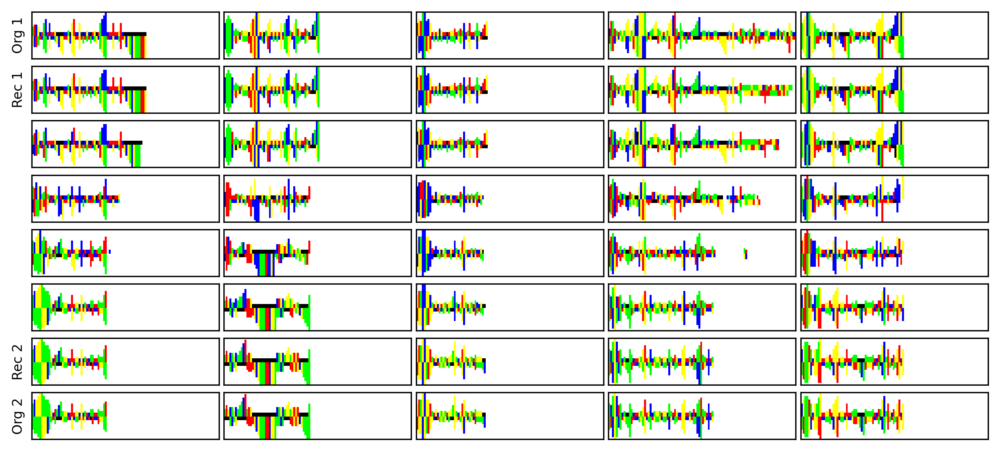

In [47]:
f = change_multiple(5)
plt.tight_layout(h_pad=-5, w_pad=-0.05)

In [48]:
f.savefig('figures/latchange.png')

In [99]:
im1_cat, im1, y, m = test_loader.dataset.__getitem__(5392)

In [100]:
im1_cat = torch.tensor(im1_cat).to('cuda').float()[None]
y = torch.tensor(y).to('cuda').float()[None]
m = torch.tensor(m).to('cuda').float()[None]

In [101]:
msk = np.ones((8,25,100,4))
msk[:,:,:,3] = 0
m0 = m.clone()

m1 = m.clone()
m1[:,:,:10] = 0
m1[:,:,10:18] = 1
msk[2,:,20:] = 0.5


m2 = m.clone()
m2[:,:,3:12] = 1
msk[3,:,15:] = 0.5



m3 = m.clone()
m3[:,:,60:67] = 1
m3[:,:,69:74] = 1
msk[4,:,:58] = 0.5

m4 = m.clone()
m4[:,:,3:27] = 1
msk[5,:,32:] = 0.5

m5 = m.clone()
m5[:,:,35:] = 0
m5[:,:,50:80] = m[:,:,35:65]
msk[6,:,:32] = 0.5

m6 = m.clone()
m6[:,:,55:63] = 1
m6[:,:,65:69] = 1
m6[:,:,72:80] = 1
msk[7,:,:54] = 0.5


In [102]:
def dec_m(m):
    n = m.shape[0]
    zm, zms = model.priors_m(im1_cat,y,m)
    
    for i in range(n):
        if i % 4 != 0:
            zm[i] = dist.Normal(zm[i], zms[i]).sample()
    
    _, c, lt, lb = model.dec([zx.repeat(n,1),zy.repeat(n,1),zm])
    rec_a = model.dec.sample(c, lt, lb)
    return rec_a

In [103]:
zy = diva_encoder(im1_cat, True, model.encs_y, model.flows_y)
zx = diva_encoder(im1_cat, True, model.encs_x, model.flows_x)

In [104]:
__ms = []
_ms = [m,m0,m1,m2,m3,m4,m5,m6]

for i in _ms:
    __ms.append(i)
    __ms.append(i)
    __ms.append(i)
    __ms.append(i)

ms = torch.cat(__ms,0)
recs = dec_m(ms)
recs[0] = torch.tensor(np.transpose(im1, (1,2,0)))

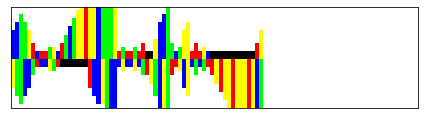

In [113]:
plt.imshow(np.transpose(im1,(1,2,0)))
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/rnaexample.png')

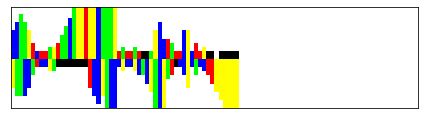

In [119]:
plt.imshow(recs[4])
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/rnaexample1.png')

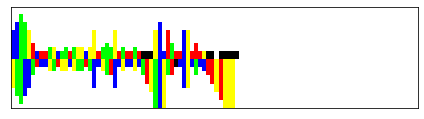

In [125]:
plt.imshow(recs[20])
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/rnaexample3.png')

In [123]:
plt.imshow(m[0].cpu())
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/mfeexample.png')

In [124]:
plt.imshow(m4[0].cpu())
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/mfeexample2.png')

In [117]:
recs.shape

torch.Size([32, 25, 100, 3])

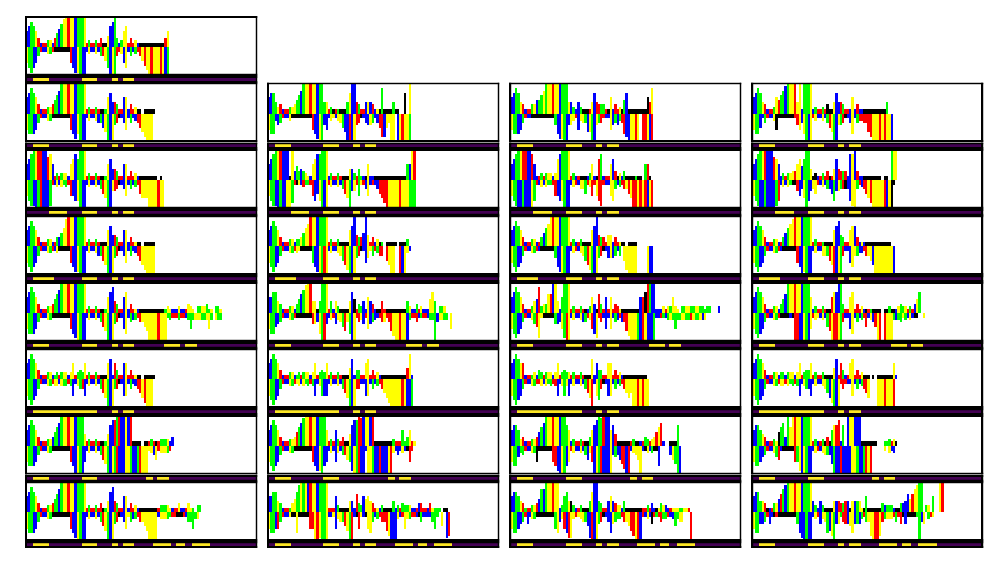

In [67]:
fig, ax = plt.subplots(ncols=4, nrows=16,
                       gridspec_kw={
                           'width_ratios': [100, 100, 100, 100],
                           'height_ratios': [25, 2, 25, 2, 25, 2, 25, 2,
                                             25, 2, 25, 2, 25, 2, 25, 2],
                       'wspace': 0.05,
                       'hspace': -0.8}, figsize=(7,5), dpi=400)

for i in range(8):
    for j in range(4):
        
        if i == 0 and j > 0:
            ax[0,j].imshow(np.ones((25,100,3)))
            
            ax[1,j].imshow(np.ones((2,100,3)))
            
            ax[0,j].axis('off')
            ax[1,j].axis('off')
        else:
            ax[2*i, j].imshow(recs[4*i+j])
            #ax[2*i, j].imshow(msk[i])
            ax[i*2+1,j].imshow(_ms[i][0].cpu())


        ax[i*2,j].set_xticks([],[])
        ax[i*2+1,j].set_xticks([],[])
        ax[i*2,j].set_yticks([],[])
        ax[i*2+1,j].set_yticks([],[])

plt.tight_layout()
fig.savefig('figures/mfeprior.png', bbox_inches="tight")

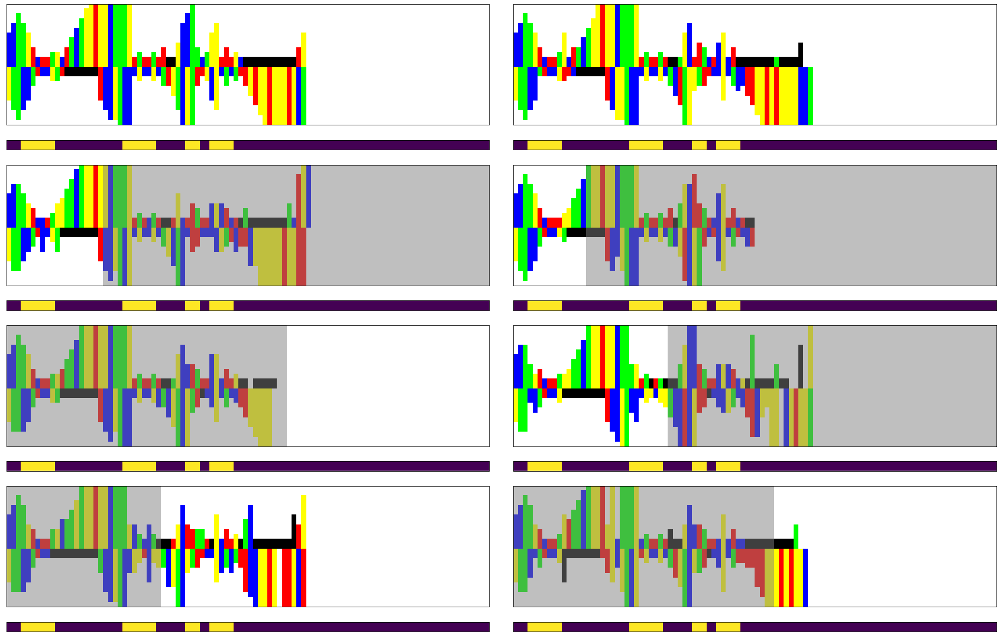

In [58]:
fig, ax = plt.subplots(ncols=2, nrows=8,
                       gridspec_kw={
                           'width_ratios': [100, 100],
                           'height_ratios': [25, 2, 25, 2, 25, 2, 25, 2],
                       'wspace': 0.05,
                       'hspace': -0.8}, figsize=(30,30))

for i in range(2):
    for j in range(4):
        ax[j*2,i].imshow(recs[j*2+i])
        ax[j*2,i].imshow(msk[j*2+i])
        ax[j*2+1,i].imshow(ms[j*2+i].cpu())
        
        
        ax[j*2,i].set_xticks([],[])
        ax[j*2+1,i].set_xticks([],[])
        ax[j*2,i].set_yticks([],[])
        ax[j*2+1,i].set_yticks([],[])

#plt.tight_layout(pad=0)
fig.savefig('figures/mfeprior2.pdf')

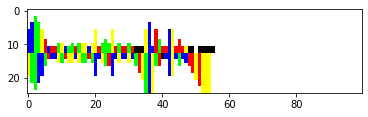

In [59]:
plt.imshow(dec_m(m4)[0])

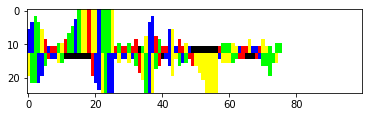

In [60]:
plt.imshow(dec_m(m6)[0])

In [61]:
im1_cat, im1, y, m = test_loader.dataset.__getitem__(1500)

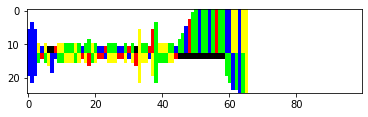

In [62]:
plt.imshow(np.transpose(im1, (1,2,0)))

In [63]:
mm = np.flip(np.flip(m,1).cumsum(1),1)
mm[1] = -mm[1]

In [64]:
mm.max()

36

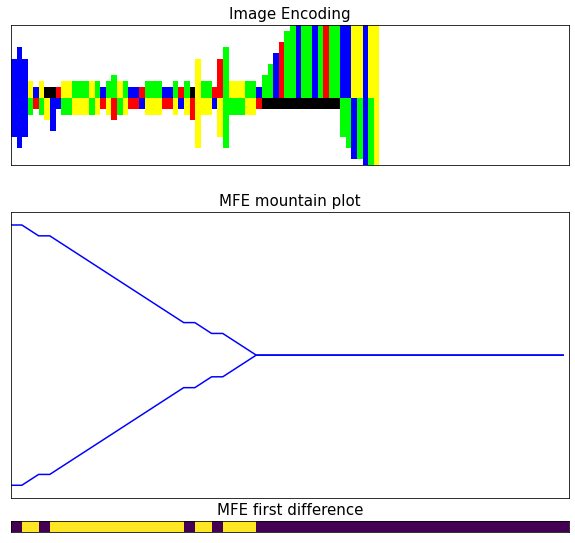

In [65]:
fig, ax = plt.subplots(nrows=3, figsize=(10,10),
                      gridspec_kw={
                           'width_ratios': [10],
                           'height_ratios': [17.5, 25, 2],
                       'wspace': 0.05,
                       'hspace': 0.1})
ax[0].imshow(np.transpose(im1, (1,2,0)))
ax[0].set_title('Image Encoding', fontsize=15)
ax[1].plot(mm[0], c='b')
ax[1].plot(mm[1], c='b')
ax[1].set_title('MFE mountain plot', fontsize=15)
ax[1].set_xlim(0,100)
ax[2].imshow(m)
ax[2].set_title('MFE first difference', fontsize=15)
for i in range(3):
    ax[i].set_yticks([],[])
    ax[i].set_xticks([],[])
plt.tight_layout()
fig.savefig('figures/mfe.pdf')

In [66]:

np.cumsum(m[::-1],1)[::-1] 

array([[ 0,  0,  1,  2,  3,  3,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12,
        13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 27,
        27, 28, 29, 30, 30, 30, 31, 32, 33, 34, 35, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36],
       [ 0,  0,  1,  2,  3,  3,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12,
        13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 27,
        27, 28, 29, 30, 30, 30, 31, 32, 33, 34, 35, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36, 36,
        36, 36, 36, 36]], dtype=int32)

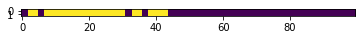

In [597]:
plt.imshow(m)

In [327]:
for i in concepts_test.columns:
    print(i, np.unique(concepts_test[i]))

Unnamed: 0 [    0     1     2 ... 14878 14879 14880]
idx [    0     1     2 ... 14878 14879 14880]
class_label [0 1]
presence_terminal_loop [False  True]
start_loop_upperhalf_col [-1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18.
 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 33. 34. 35. 36.
 38. 39. 40. 41. 42. 44. 45. 47. 48. 49. 50. 59.]
highest_point_loop_upperhalf_row [-1.  0.  1.  2.  3.  4.  5.  6.  7.]
highest_point_loop_upperhalf_col [-1.  0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16.
 17. 18. 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 35. 36.
 37. 38. 39. 42. 44. 46. 47. 56.]
loop_length [ 0. 12. 14. 15. 16. 18. 19. 20. 22. 24. 25.]
loop_width [ 0.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18. 19.
 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30. 31. 32. 33. 34. 35. 36. 37.
 39. 40. 41. 42. 43. 45. 46. 48. 49. 50. 51. 60.]
gap_start [-1.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 1

In [108]:
df = pd.DataFrame(columns=['a','b'])
df.loc['uga'] = {'a':1,'b':23}

In [109]:
df

,a,b
uga,1,23


In [93]:
nuc = correct_nucleotides(x_te, x_hat_te)

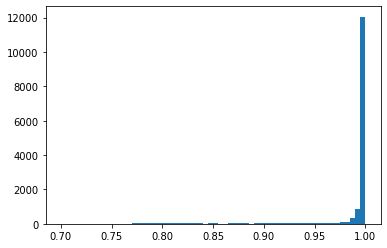

In [104]:
plt.hist(nuc.mean(axis=(1,2)), bins=np.arange(0.7,1,0.005));

In [111]:
lnt = correct_shape(x_te, x_hat_te)

In [114]:
lnt.mean()

0.9954549963901658

In [98]:
nuc.mean(axis=(1,2))

array([1., 1., 1., ..., 1., 1., 1.])

In [13]:
def calculate_error_statistics(x, x_hat):
    '''
    function which calculates all reconstruction statistics
    '''
    correct_nt = correct_nucleotides(x, x_hat)
    correct_sh = correct_shape(x, x_hat)
    correct_le = correct_length(x, x_hat)
    return correct_nt, correct_sh, correct_le
    
def correct_nucleotides(x, x_hat):
    '''
    calculates which nucleotides are correct
    '''
    return (x[:,:,12:14]==x_hat[:,:,12:14]).prod(1)

def wrong_shape(x, x_hat):
    '''
    calculates how correct the shape is
    '''
    x, x_hat = x.sum((1,)), x_hat.sum((1,))
    a = 13-(x[:,:13] == x_hat[:,:13]).sum(1)
    b = 12-(x[:,13:] == x_hat[:,13:]).sum(1)
    result = np.concatenate((a,b),axis=1)
    return result

def correct_length(x, x_hat):
    '''
    calculates which part of the length of the reconstruction is correct
    '''
    x, x_hat = x[:,:,12:13].sum(1), x_hat[:,:,12:13].sum(1) 
    return x == x_hat

In [ ]:
z_tr, x_hat_tr, x_tr = model_analysis(model, args, train_loader)
z_te, x_hat_te, x_te = model_analysis(model, args, test_loader)

In [11]:
latent_space_m = TSNE().fit_transform(z_te['m'])

In [12]:
fig = go.FigureWidget(
    data=[
        dict(
            type='scattergl',
            x=latent_space_m[:,0],
            y=latent_space_m[:,1],
            mode='markers',
            marker = dict(color=np.argmax(test_loader.dataset.labels,1),
                          size=4),
          
        )
    ],
    
    layout=dict(height=500, width=750)
)

In [13]:
def set_color(column):
    fig.data[0].marker.color = concepts_test[column]*1

In [14]:
radio = RadioButtons(options=concepts_test.columns[2:])
radiowidget = interact(set_color, column=radio)

interactive(children=(RadioButtons(description='column', options=('class_label', 'presence_terminal_loop', 'st…

In [15]:
def compress_to_bytes(data, fmt):
    """
    Helper function to compress image data via PIL/Pillow.
    """
    data = data.repeat(10, axis=0).repeat(10, axis=1)
    buff = io.BytesIO()
    img = PIL.Image.fromarray(np.uint8(data*255))    
    img.save(buff, format=fmt)
    
    return buff.getvalue()

def hover_fn(trace, points, state):

    ind = points.point_inds[0]

    
    # Update image widget
    im = compress_to_bytes(test_loader.dataset.images[ind],'png')
    image_widget.value = im
    details.value = pd.DataFrame({'name':[test_loader.dataset.names[ind]], 'class':[test_loader.dataset.labels.argmax(1)[ind]]}).to_html(col_space={'name':250,'class':50})
    
details = HTML()
details.value = pd.DataFrame({'name':[test_loader.dataset.names[0]], 'class':[test_loader.dataset.labels.argmax(1)[0]]}).to_html(col_space={'name':250,'class':50})

In [16]:
fig.data[0].on_hover(hover_fn)

In [17]:
fmt='png'
im = compress_to_bytes(test_loader.dataset.images[0],fmt)
image_widget = Image(
    value=im,
    layout=Layout(height='250px', width='1000px')
)

In [18]:
VBox([HBox([fig, 
      radio]), HBox([image_widget]), details])

    'data': [{'marker': {'color': array([0, 0, 1, ..., 1, 0, 0], …

In [68]:
from decisiontree import Tree

In [69]:

thresholds = {'start_loop_upperhalf_col':[3,7,15,30,45],
              'highest_point_loop_upperhalf_col':[3,7,9,15,30,45],
              'gap_start':[2,8,20,40],
              'palindrome_score':[.25,.5,.6,.7,.8,.9],
              'large_asymmetric_bulge':[2,4,8,10,20,40,60],
              'largest_asym_bulge_sequence_location':[5,20,40,60,80],
              'stem_begin':[15,35,45,55,60,75],
              'stem_end':[3,5,8,12,20,30,40],
              'stem_length':[10,20,30,35,40,45,50,55,60,70,80,90],
              'total_length':[20,30,40,50,60,70,80,90],
              'base_pairs_in_stem':[.1,.3,.5,.7,.9],
              'base_pairs_wobbles_in_stem':[.1,.3,.5,.7,.9],
              'loop_width':[2,8,20,45],
              
              }

In [70]:
dtc = Tree(thresholds, max_depth=4, cls=LinearSVC,
       cls_args=dict(dual=False), min_acc=0.9)

In [71]:
dtc.fit(z_diva_tr['m'], train_loader.dataset.labels.argmax(1).flatten(), concepts_train[concepts_train.columns[3:]], prune=True)

In [72]:
dtc.score(z_diva_tr['m'], train_loader.dataset.labels.argmax(1).flatten())

0.939258661904899

In [73]:
dtc.score(z_te['m'], test_loader.dataset.labels.argmax(1).flatten())

0.9115650829917344

In [84]:
g = dtc.plot_tree()
g.render('dtc_zm', format='png')

'dtc_zm.png'

In [85]:
rt = dtc.root

In [86]:
cl = rt.rule_cls.predict(z_diva['m'])

In [87]:
(cl == (concepts_test['base_pairs_in_stem']>0.5).values).mean()

0.9278946307371816

In [88]:
from sklearn.neighbors import KNeighborsClassifier as knn

In [89]:
cls1 = knn(3)

In [90]:
cl==0

array([ True,  True, False, ..., False,  True,  True])

In [91]:
cls1.fit(X=latent_space_m, y=cl)

KNeighborsClassifier(n_neighbors=3)

In [92]:
 xx, yy = np.meshgrid(np.arange(-80, 80, 0.25),
                     np.arange(-80, 90, 0.25))

In [93]:
Z=cls1.predict(np.c_[xx.ravel(), yy.ravel()])

In [94]:
Z = Z.reshape(xx.shape)

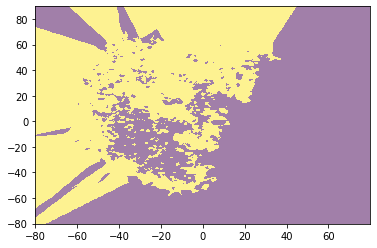

In [95]:
plt.pcolormesh(xx, yy, Z,alpha=.5)#cmap=cmap_light)

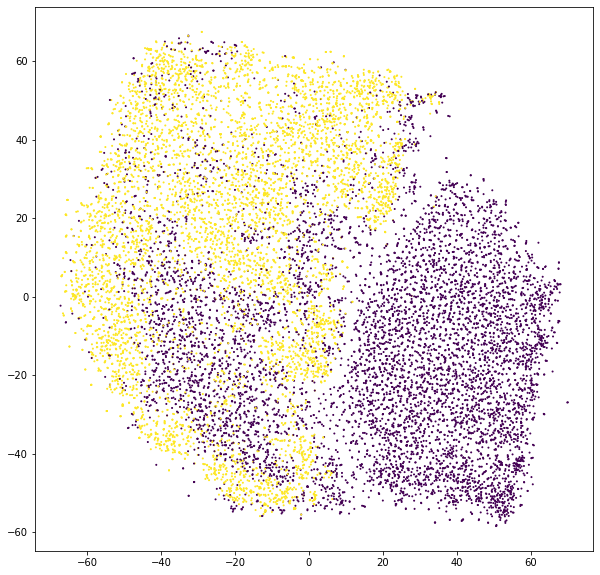

In [96]:
plt.figure(figsize=(10,10))
plt.scatter(latent_space_m[:,0],latent_space_m[:,1], c=cl,s=1)

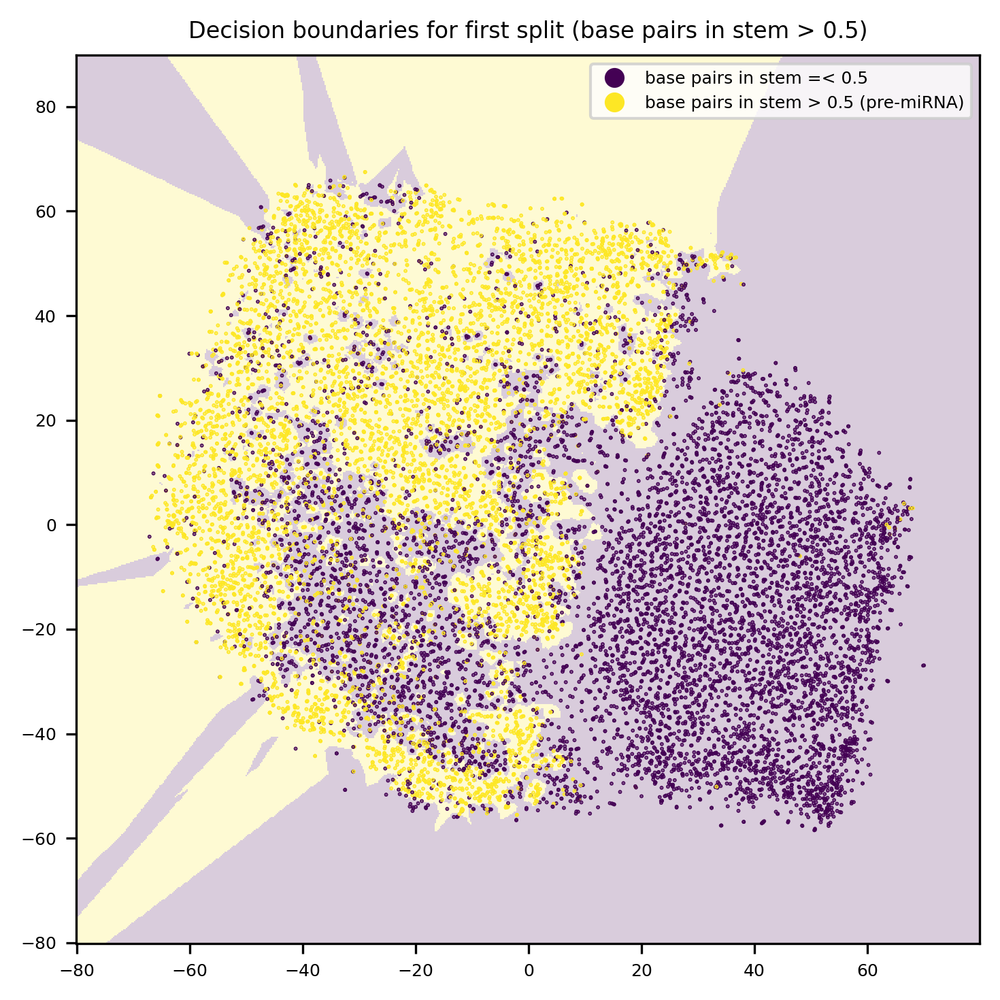

In [250]:
plt.figure(figsize=(5,5), dpi=300)
plt.pcolormesh(xx, yy, Z,alpha=.2)
sc = plt.scatter(latent_space_m[:,0],latent_space_m[:,1], c=concepts_test['base_pairs_in_stem']>0.5,s=0.15)
handles, _ = sc.legend_elements()
labels = ['base pairs in stem =< 0.5', 'base pairs in stem > 0.5 (pre-miRNA)']
plt.legend(handles, labels, fontsize=6)
plt.title("Decision boundaries for first split (base pairs in stem > 0.5)", fontsize=8)
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.tight_layout()
plt.savefig('figures/split1.pdf')

In [98]:
cl2 = rt.left_child.rule_cls.predict(z_diva['m'][cl==0])

In [99]:
cls2 = knn(3)
cls2.fit(latent_space_m[cl==0], cl2)

KNeighborsClassifier(n_neighbors=3)

In [100]:
((concepts_test['stem_length']>70).values[cl==0] == cl2).mean()

0.988944099378882

In [101]:
Z2=cls2.predict(np.c_[xx.ravel(), yy.ravel()])

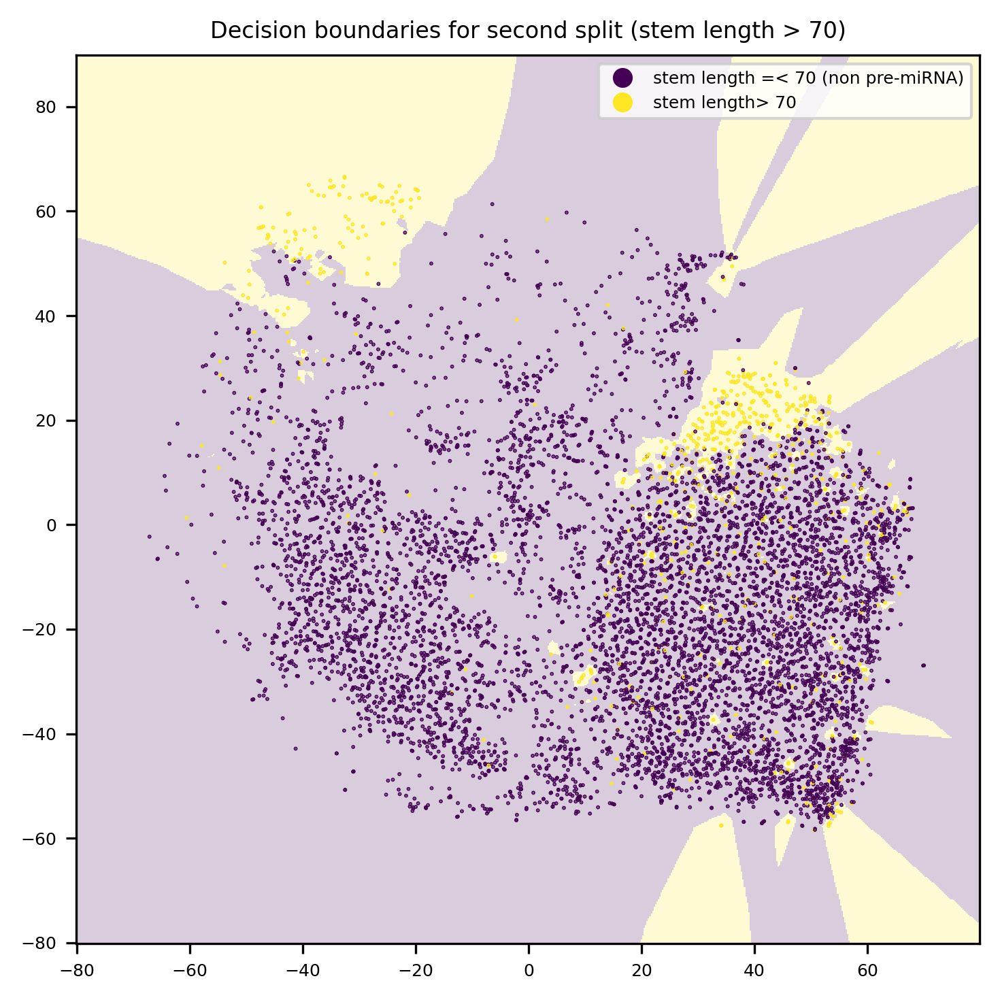

In [253]:
plt.figure(figsize=(5,5), dpi=300)
plt.pcolormesh(xx, yy, Z2.reshape(xx.shape),alpha=.2)
sc = plt.scatter(latent_space_m[cl==0,0],latent_space_m[cl==0,1], c=(concepts_test['stem_length']>70).values[cl==0],s=0.15)
handles, _ = sc.legend_elements()
labels = ['stem length =< 70 (non pre-miRNA)', 'stem length> 70']
plt.legend(handles, labels, fontsize=6)
plt.title("Decision boundaries for second split (stem length > 70)", fontsize=8)
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.tight_layout()
plt.savefig('figures/split2.pdf')

In [103]:
cl2 == 1

array([False, False, False, ..., False, False, False])

In [104]:
cl3 = rt.left_child.right_child.rule_cls.predict(z_diva['m'][cl==0][cl2==1])

In [105]:
cls3 = knn(3)
cls3.fit(latent_space_m[cl==0][cl2==1], cl3)

KNeighborsClassifier(n_neighbors=3)

In [106]:
((concepts_test['asymmetric']).values[cl==0][cl2==1] == cl3).mean()

0.9051204819277109

In [107]:
Z3=cls3.predict(np.c_[xx.ravel(), yy.ravel()])

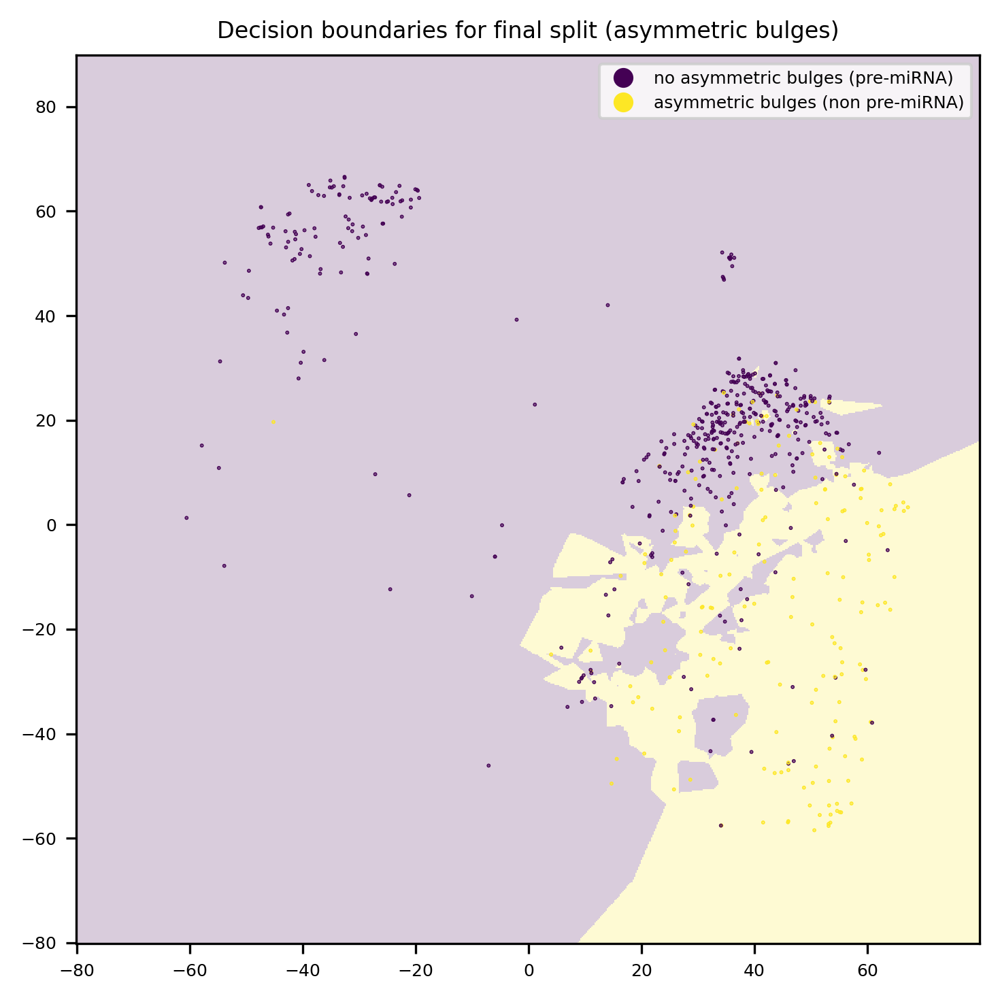

In [254]:
plt.figure(figsize=(5,5), dpi=300)
plt.pcolormesh(xx, yy, Z3.reshape(xx.shape),alpha=.2)
sc = plt.scatter(latent_space_m[cl==0,0][cl2==1],latent_space_m[cl==0,1][cl2==1], c=(concepts_test['asymmetric']).values[cl==0][cl2==1],s=.15)
handles, _ = sc.legend_elements()
labels = ['no asymmetric bulges (pre-miRNA)', 'asymmetric bulges (non pre-miRNA)']
plt.legend(handles, labels, fontsize=6)
plt.title("Decision boundaries for final split (asymmetric bulges)", fontsize=8)
plt.xticks(fontsize=6)
plt.yticks(fontsize=6)
plt.tight_layout()
plt.savefig('figures/split3.pdf')

In [566]:
g = dtc.plot_tree()
g.render('dtc_zy', format='png')

'dtc_zy.png'

In [26]:
def plot_latent_space(z, c):
    plt.scatter(z[:,0], z[:,1], c=c, s=.1)

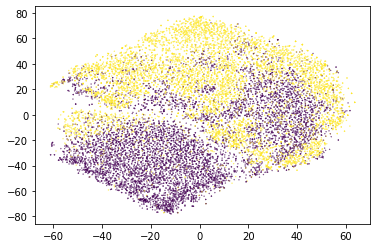

In [27]:
plot_latent_space(latent_space_m,test_loader.dataset.labels.argmax(1).flatten())

In [29]:
nt, sh, le = calculate_error_statistics(test_loader.dataset.images_cat, x_hat_te)

In [30]:
nt.mean()

0.9957745447214569

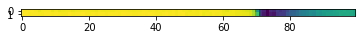

In [31]:
plt.imshow(nt.prod(axis=1).mean(0))

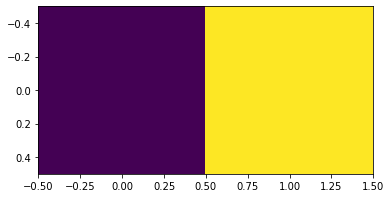

In [32]:
plt.imshow([[0,1]])

In [ ]:
nt.mean()

In [695]:
1-x_te.sum(1).mean()

0.7922422955446542

In [71]:
np.prod([True,False])

0

In [12]:
err = 1 - (x_te ==  x_hat_te).prod(1)

In [13]:
err.max()

1

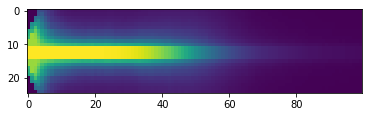

In [22]:
plt.imshow(x_te.sum(1).mean(0))

In [30]:
err.sum(0).max()

917

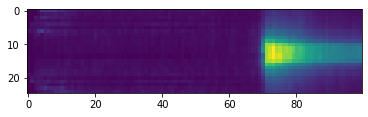

In [29]:
plt.imshow(err.sum(0))

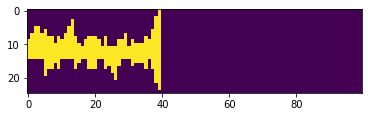

In [16]:
plt.imshow(x_te[1].sum(0))

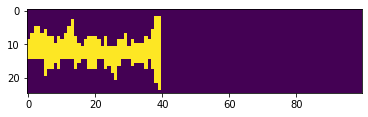

In [17]:
plt.imshow(x_hat_te[1].sum(0))

In [32]:
torch.nn.functional.one_hot(torch.tensor([[1,2,3,4]])).argmax(2)

tensor([[1, 2, 3, 4]])

In [39]:
concepts_test[concepts_test.columns[3:]]['presence_terminal_loop']*1.0

0        1.0
1        0.0
2        1.0
3        1.0
4        1.0
        ... 
14876    1.0
14877    0.0
14878    1.0
14879    0.0
14880    0.0
Name: presence_terminal_loop, Length: 14881, dtype: float64

In [42]:
np.corrcoef([1,2,3],[2,3,4])

array([[1., 1.],
       [1., 1.]])

In [45]:
z_tr['m'].shape

(34721, 64)

In [268]:
def get_top_cor(col, z, top = 4):
    cor = np.zeros((z.shape[1],))
    
    for i in range(z.shape[1]):
        cor[i] = spearmanr(z[:,i], col)[0]
    
    cor_abs = np.abs(cor)
    idx = np.argsort(cor_abs)[::-1][:top]
    
    return cor[idx], idx

In [272]:
for i in concepts_test.columns[3:]:
    c, idx = get_top_cor(concepts_test[i]*1.0, z_te['y'])
    print(f'{i}: {c} {idx}')

presence_terminal_loop: [-0.35148618  0.28434148  0.28093876  0.2513    ] [50 27 46 55]
start_loop_upperhalf_col: [-0.3234461   0.26328114  0.26005171  0.24402772] [50 46 27 55]
highest_point_loop_upperhalf_row: [-0.25852297  0.20587235  0.1991003  -0.18148679] [50 27 46 21]
highest_point_loop_upperhalf_col: [-0.33000964  0.26890786  0.26288949  0.24843706] [50 46 27 55]
loop_length: [-0.32159526  0.26467556  0.26355054  0.24490361] [50 46 27 55]
loop_width: [-0.3234461   0.26328114  0.26005171  0.24402772] [50 46 27 55]
gap_start: [ 0.34397362 -0.27791569 -0.27661786 -0.24766532] [50 46 27 55]
palindrome_score: [-0.58973101  0.4488451   0.44737228  0.42611431] [50 27 55 46]
asymmetric: [ 0.3310542  -0.26373583 -0.26178207 -0.24099501] [50 27 46 55]
large_asymmetric_bulge: [ 0.39835366 -0.30842425 -0.2899725  -0.25911873] [50 55 27 46]
largest_asym_bulge_strand_location: [ 0.25842652  0.1868645  -0.18205823 -0.18178637] [28 50 36 55]
largest_asym_bulge_sequence_location: [ 0.33900712 -

In [53]:
zm = z_te['m']
for i in range(z_te['m'].shape[1]):
    print(f'{i} {pearsonr(zm[:,i], concepts_test[concepts_test.columns[3:]].presence_terminal_loop*1.0)[0]}')

0 0.14011964418587936
1 -0.027015324318706783
2 0.1991583660723179
3 -0.1049297130229704
4 0.19832440820562253
5 0.13287836359825936
6 0.23466439947330586
7 0.06334974325076338
8 0.11674723201531483
9 -0.4452833409510196
10 -0.49608752979514387
11 -0.36696632878720475
12 0.05617992704115656
13 -0.21357974586073614
14 -0.059297594591091296
15 -0.5293271054006033
16 -0.10842481273624902
17 -0.14224310932137238
18 -0.033417921989922314
19 -0.014186637399854735
20 0.004550212165171738
21 -0.24378098776032134
22 0.054195609586182504
23 -0.33691611951137923
24 0.1258934180680727
25 0.2398785066049379
26 0.07796792355533294
27 -0.4389409531723619
28 0.030841717516145298
29 0.12956302422331903
30 0.003635947117515877
31 0.0809915116192387
32 0.14813465536844542
33 -0.0004301033636026912
34 0.4520972377860495
35 0.3125245503842604
36 0.04955017393051441
37 0.19405270375429307
38 0.13333841816924402
39 -0.30401115862723893
40 0.08990965571294034
41 0.1646053626676956
42 -0.254237682789763
43 0.0

In [51]:
zm[:,i].shape, (concepts_test[concepts_test.columns[3:]].presence_terminal_loop*1.0).shape

((34721,), (14881,))

In [236]:
stamp = torch.tensor([[0,0,0,0,0],
                      [1,1,0,0,0],
                      [1,1,1,0,0],
                      [1,1,1,1,0],
                      [1,1,1,1,1]]).float()[None]

In [237]:
stamp

tensor([[[0., 0., 0., 0., 0.],
         [1., 1., 0., 0., 0.],
         [1., 1., 1., 0., 0.],
         [1., 1., 1., 1., 0.],
         [1., 1., 1., 1., 1.]]])

In [248]:
top = torch.tensor([[0.1,0.3,0.4,0.2,0],
                   [0.05,0.05,0.1,0.3,0.5],
                   [0.,0.1,0.2,0.4,.3],
                   [0.2,0.7,0.1,0.,0],
                   [0.2,0.3,0.4,0.1,0],
                   [0.1,0.3,0.4,0.2,0],
                   [0.2,0.3,0.4,0.1,0],
                   [0.7,0.3,0.0,0.0,0],
                   [0.8,0.1,0.1,0.0,0]])[None].flip(2)

In [310]:
colores = torch.tensor([[1,0,0],
                        [0,1,0],
                        [1,1,0],
                        [0,0,0],
                        [0,0,1],
                        [1,1,0],
                        [1,0,0],
                        [1,1,0],
                        [0,1,0]]
                        )[None].float()

In [311]:
top.sum(dim=2)

tensor([[1., 1., 1., 1., 1., 1., 1., 1., 1.]])

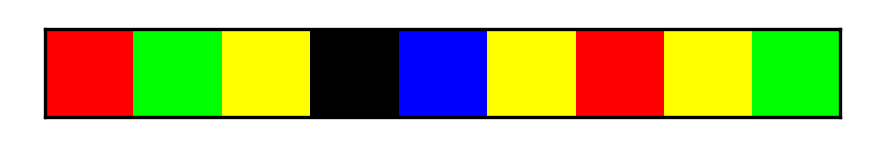

In [338]:
plt.figure(figsize=(3,1), dpi=300)
plt.imshow(colores)
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/stamp/cols.png')

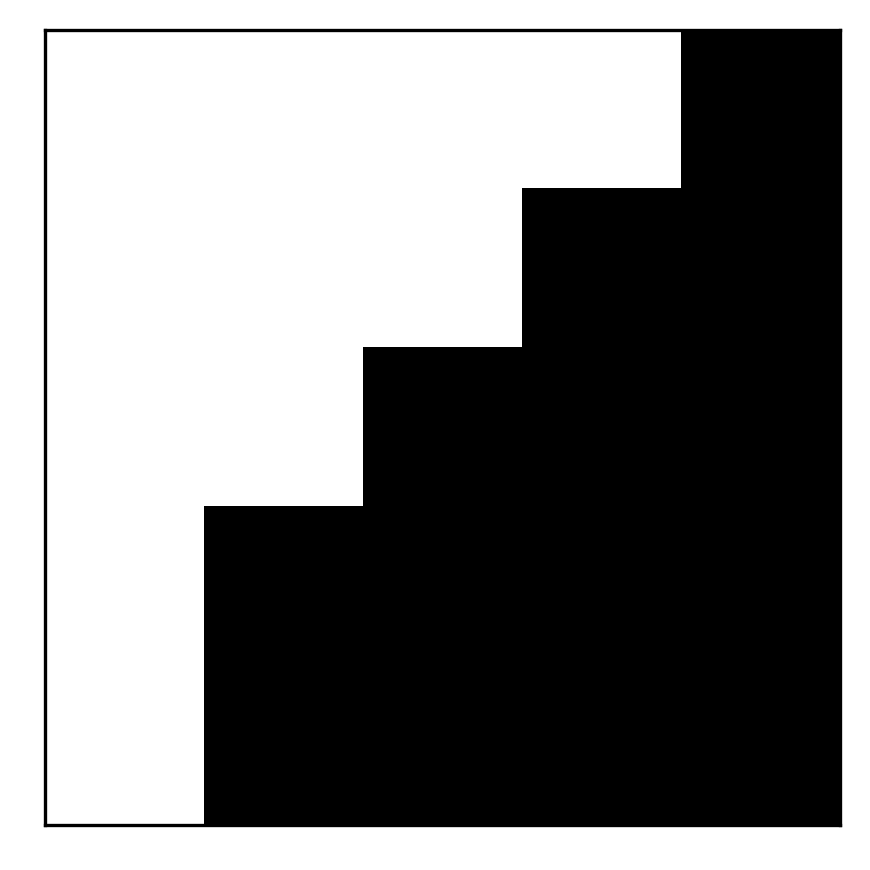

In [339]:
plt.figure(figsize=(3,3), dpi=300)
plt.imshow(stamp[0].flip(1).permute(1,0),cmap="Greys")
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/stamp/stamp.png')

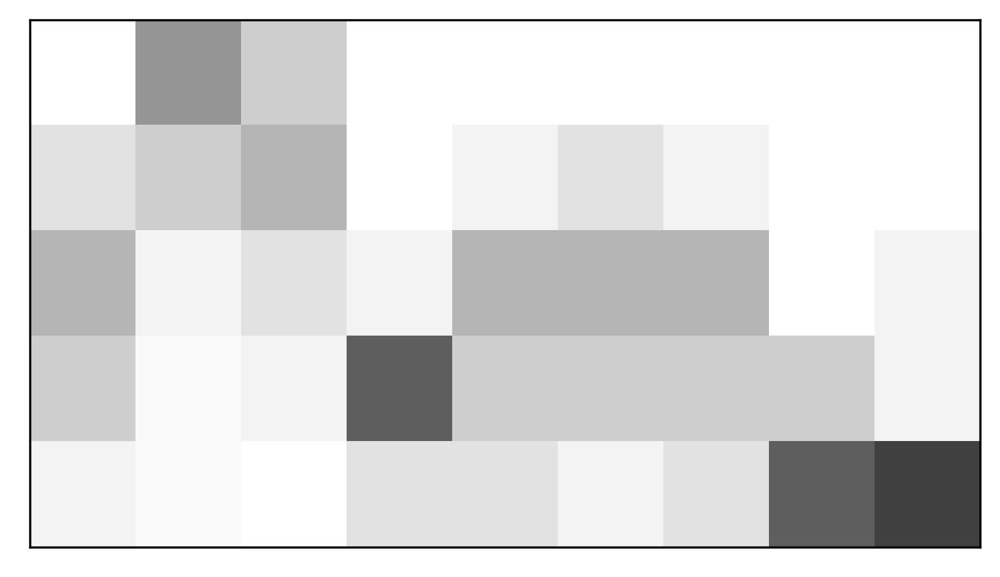

In [340]:
plt.figure(figsize=(6,3), dpi=300)
plt.imshow(top[0].permute(1,0), cmap='Greys', vmin=0, vmax=1)
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/stamp/prob.png')

In [315]:
bm = torch.bmm(top.flip(2), stamp.flip(2))

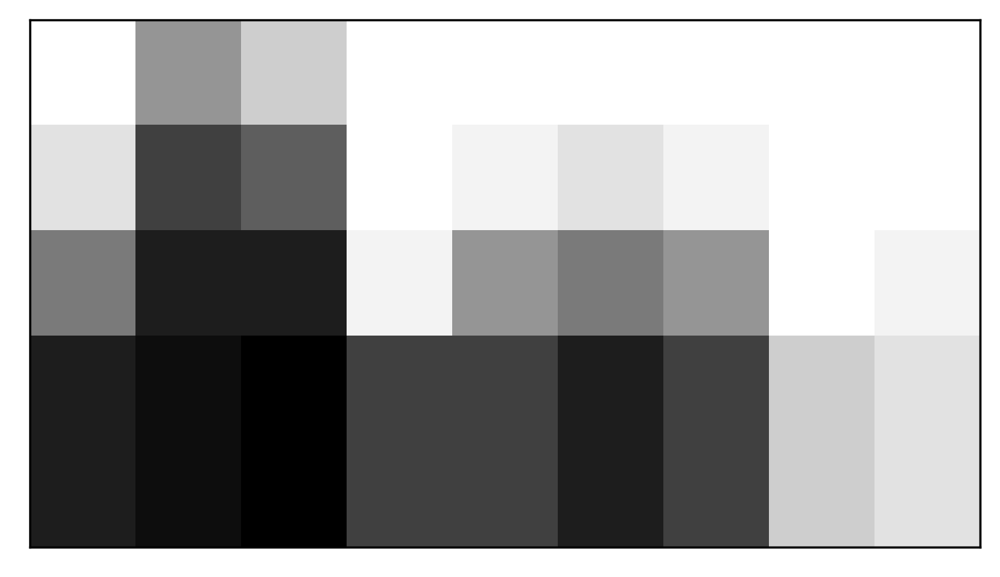

In [341]:
plt.figure(figsize=(6,3), dpi=300)
plt.imshow(bm[0].permute(1,0), cmap='Greys', vmin=0, vmax=1)
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/stamp/probstamp.png')

In [317]:
bm.shape, colores.shape

(torch.Size([1, 9, 5]), torch.Size([1, 9, 3]))

In [318]:
cl = colores[:,:,None].repeat(1,1,5,1)

In [319]:
ja = torch.cat([cl, bm[:,:,:,None]], 3)

In [321]:
ja.shape

torch.Size([1, 9, 5, 4])

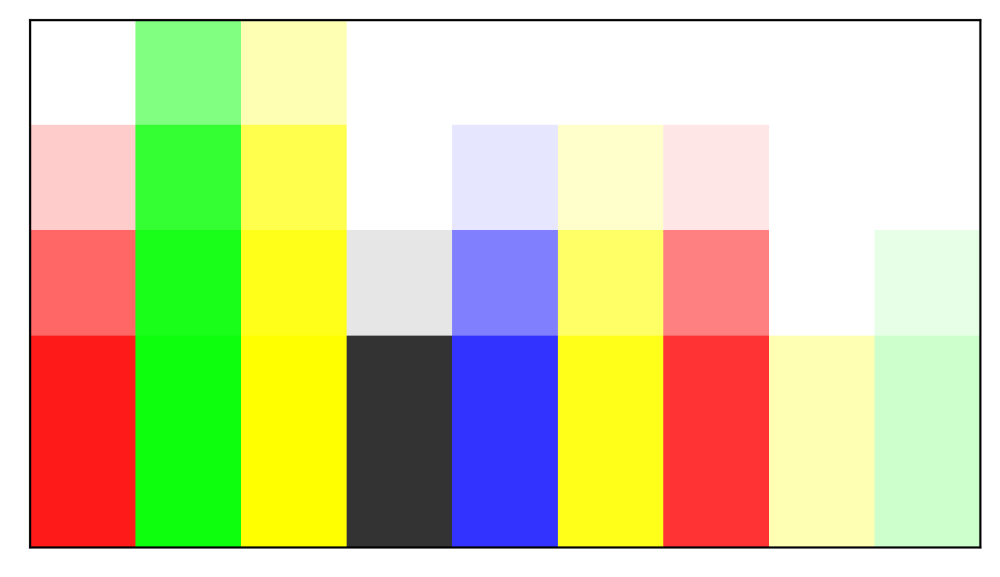

In [342]:
plt.figure(figsize=(6,3), dpi=300)
plt.imshow(ja[0].permute(1,0,2))
plt.xticks([],[])
plt.yticks([],[])
plt.tight_layout()
plt.savefig('figures/stamp/probstampcol.png')

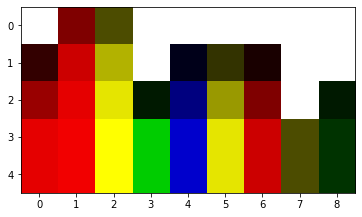

In [298]:
plt.imshow(ja1[0].permute(1,0,2))